<a id='top'></a>

# *Mobility Data Analysis project - Google Maps data Study Case* 

In this project, we will study the geographical data of the positions of a person, gathered from Google Maps location history.

## Table of Contents
1. [The dataset](#dataset) 
2. [Noise removal](#noise) 
    1. [Visualizing data](#vd)
3. [Trajectories](#tr)
    1. [On vacation](#tr)
    2. [Working period](#wp)
4. [Turin areas](#turin)
    1. [Starting trajectories](#sttr)
    2. [Arriving trajectories](#artr)
5. [Minimovies](#movie)
    1. [Working period](#movie)
    2. [On vacation](#vacation)
6. [Trajectory clustering](#tc)
    1. [K-Means](#km)
        1. [Working period](#km)
        2. [Business trips](#btr)
    2. [DBSCAN](#dbscan)
7. [Significant indices](#indices)
    1. [Radius of gyration](#rog)
        1. [Sequential period](#rogseq)
        2. [Incremental period](#roginc)
            1. [Month](#roginc)
            2. [Week](#rogweek)
        3. [Sequential vs incremental](#seqinc)
    2. [Uncorrelated entropy](#entropy)
        1. [Sequential vs incremental](#seqincmonth)
            1. [Month](#seqincmonth)
            2. [Week](#seqincweek)
8. [Profiling](#profile)
    1. [Home location](#profile)
9. [Conclusions](#conclusions)

In [1]:
                    %matplotlib inline
import matplotlib.pyplot as plt
#plotly
import plotly.plotly as py #import plotly
import plotly.graph_objs as go #import graphs objects
import plotly.figure_factory as ff

#offline mode
from plotly.offline import init_notebook_mode, iplot, plot
init_notebook_mode()

import pandas as pd
import geopandas as gpd
import json
from pandas.io.json import json_normalize
import seaborn as sns
from shapely.geometry import Point, Polygon, LineString, MultiPoint
import folium
from folium import plugins
from geopy.distance import great_circle
import numpy as np
from math import sqrt, sin, cos, pi, asin, pow, ceil, log
from scipy.stats import entropy
import sys
import os
from os import path
import time
import csv
from scipy.stats import expon
from collections import defaultdict
from random import sample, uniform, random
import datetime
from datetime import datetime
import networkx as nx
import pyepsg
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import pairwise_distances_argmin_min
from collections import namedtuple

import warnings
warnings.filterwarnings("ignore")

## Functions definitions

In [2]:
def earth_distance(lat_lng1, lat_lng2):
    """
    Compute the distance (in km) along earth between two lat/lon pairs
    :param lat_lng1: tuple
        the first lat/lon pair
    :param lat_lng2: tuple
        the second lat/lon pair

    :return: float
        the distance along earth in km
    """
    lat1, lng1 = [l*pi/180 for l in lat_lng1]
    lat2, lng2 = [l*pi/180 for l in lat_lng2]
    dlat, dlng = lat1-lat2, lng1-lng2
    ds = 2 * asin(sqrt(sin(dlat/2.0) ** 2 + cos(lat1) * cos(lat2) * sin(dlng/2.0) ** 2))
    return 6371.01 * ds  # spherical earth...


In [3]:
def radius_of_gyration(user_gdf):
    """
    Compute the radius of gyration (in kilometers) of an individual. The radius of gyration $r_g$ is a measure that 
    indicates the characteristic distance travelled by an individual during a time period. 
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the radius of gyration
        
    Returns
    -------
    rg: float
        the radius of gyration of the individual
        
    See also
    --------
    k_radius_of_gyration, radii_of_gyration, k_radii_of_gyration
        
    References
    ----------
    .. [1] Gonzalez, Marta C., Hidalgo, Cesar A. and Barabasi, Albert-Laszlo. 
    "Understanding individual human mobility patterns." 
    Nature 453 , no. 7196 (2008): 779--782.
    
    .. [2] Pappalardo, L., Rinzivillo, S., Qu, Z., Pedreschi, D., Giannotti, F. 
    "Understanding the patterns of car travel."
    European Physics Journal Special Topics 215, no. 61 (2013).
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> radius_of_gyration(data[data.user == 0])
    18.05107972735531
    """
    
    lats_lons = user_gdf[['lat', 'lon']].values
    center_of_mass = np.mean(lats_lons, axis=0)
    rg = np.sqrt(np.mean([earth_distance((lat, lon), center_of_mass) ** 2.0 for lat, lon in lats_lons]))
    return rg

def radii_of_gyration(gdf):
    """
    Compute the radii of gyration (in kilometers) of all the individuals in a mobility dataset.
    
    Parameters
    ----------
    gdf: pandas DataFrame
        the visits of the individuals from which to compute the radii of gyration
        
    Returns
    -------
    radii: pandas Series
        the radii of gyration of the individuals
        
    See also
    --------
    radius_of_gyration, k_radius_of_gyration, k_radii_of_gyration
    
    References
    ----------
    .. [1] Gonzalez, Marta C., Hidalgo, Cesar A. and Barabasi, Albert-Laszlo. 
    "Understanding individual human mobility patterns." 
    Nature 453 , no. 7196 (2008): 779--782.
    
    .. [2] Pappalardo, L., Rinzivillo, S., Qu, Z., Pedreschi, D., Giannotti, F. 
    "Understanding the patterns of car travel."
    European Physics Journal Special Topics 215, no. 61 (2013).
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> radius_of_gyration(data)
    user
    0    18.051080
    1    11.758258
    2    23.358970
    3     9.823990
    4    17.611092
    dtype: float64
    """
    radii = gdf.groupby('user').apply(lambda x: radius_of_gyration(x)) 
    return radii

def random_entropy(user_gdf):
    """
    The random entropy of an individual captures the degree of predictability 
    of the individual's whereabouts if each location is visited with equal probability.
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the random entropy
        
    Returns
    -------
    e: float
        the random entropy of the individual
    
    See also
    --------
    uncorrelated_entropy, uncorrelated_entropies, random_entropies, real_entropy, real_entropies
    
    References
    ----------
    .. [1] Song, Chaoming, Qu, Zehui, Blumm, Nicholas and Barabási, Albert-László. 
    "Limits of Predictability in Human Mobility." 
    Science 327 , no. 5968 (2010): 1018-1021.
    
    .. [2] Eagle, Nathan and Pentland, Alex Sandy. 
    "Eigenbehaviors: identifying structure in routine." 
    Behavioral Ecology and Sociobiology 63 , no. 7 (2009): 1057--1066.
    
    .. [3] Lu, X., Wetter, E., Bharti, N., Tatem, A. J. and Bengtsson, L.. 
    "Approaching the limit of predictability in human mobility." 
    Scientific Reports 3 (2013): 2923.
    
    .. [4] Sinatra, Roberta and Szell, Michael. 
    "Entropy and the Predictability of Online Life.." 
    Entropy 16 , no. 1 (2014): 543-556.
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> random_entropy(data[data.user == 0])
    6.832890014164741
    """
    n_distinct_locs = len(user_gdf.groupby(['lat', 'lon']))
    e = np.log2(n_distinct_locs)
    return e

def random_entropies(gdf):
    """
    Compute the random entropies of all individuals in the mobility dataset.
    
    Parameters
    ----------
    gdf: pandas DataFrame
        the visits of the individuals from which to compute the random entropies
    
    Returns
    -------
    radii: pandas Series
        the random entropies of the individuals
        
    See also
    --------
    uncorrelated_entropy, uncorrelated_entropies, random_entropy, real_entropy, real_entropies
    
    References
    ----------
    .. [1] Song, Chaoming, Qu, Zehui, Blumm, Nicholas and Barabási, Albert-László. 
    "Limits of Predictability in Human Mobility." 
    Science 327 , no. 5968 (2010): 1018-1021.
    
    .. [2] Eagle, Nathan and Pentland, Alex Sandy. 
    "Eigenbehaviors: identifying structure in routine." 
    Behavioral Ecology and Sociobiology 63 , no. 7 (2009): 1057--1066.
    
    .. [3] Lu, X., Wetter, E., Bharti, N., Tatem, A. J. and Bengtsson, L.. 
    "Approaching the limit of predictability in human mobility." 
    Scientific Reports 3 (2013): 2923.
    
    .. [4] Sinatra, Roberta and Szell, Michael. 
    "Entropy and the Predictability of Online Life.." 
    Entropy 16 , no. 1 (2014): 543-556.
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> random_entropies(data).head()
    user
    0    6.832890
    1    6.409391
    2    6.807355
    3    6.686501
    4    6.599913
    dtype: float64
    """
    return gdf.groupby('user').apply(lambda x: random_entropy(x))

def uncorrelated_entropy(user_gdf, normalize=False):
    """
    Compute the temporal-uncorrelated entropy of the individual. 
    The temporal-uncorrelated entropy is the historical probability 
    that a location j was visited by an individual i, characterizing 
    the heterogeneity his of visitation patterns.
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the temporal-uncorrelated entropy
        
    normalize: boolean
        if True normalize the entropy by dividing by log2(N), where N is the number of 
        distinct locations visited by the individual
    
    Returns
    -------
    e: float
        the temporal-uncorrelated entropy of the individual
    
    See also
    --------
    uncorrelated_entropies, random_entropy, random_entropies, real_entropy, real_entropies
    
    References
    ----------
    .. [1] Song, Chaoming, Qu, Zehui, Blumm, Nicholas and Barabási, Albert-László. 
    "Limits of Predictability in Human Mobility." 
    Science 327 , no. 5968 (2010): 1018-1021.
    
    .. [2] Eagle, Nathan and Pentland, Alex Sandy. 
    "Eigenbehaviors: identifying structure in routine." 
    Behavioral Ecology and Sociobiology 63 , no. 7 (2009): 1057--1066.
    
    .. [3] Lu, X., Wetter, E., Bharti, N., Tatem, A. J. and Bengtsson, L.. 
    "Approaching the limit of predictability in human mobility." 
    Scientific Reports 3 (2013): 2923.
    
    .. [4] Sinatra, Roberta and Szell, Michael. 
    "Entropy and the Predictability of Online Life.." 
    Entropy 16 , no. 1 (2014): 543-556.
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> uncorrelated_entropy(data[data.user == 0])
    3.905486664507274
    """
    n = len(user_gdf)
    probs = [1.0 * len(group)/n for group in user_gdf.groupby(by=['lat', 'lon']).groups.values()]
    e = entropy(probs)
    if normalize:
        vals = np.unique(user_gdf[['lat', 'lon']].values)
        e /= np.log2(len(vals))
    return e
    
def uncorrelated_entropies(gdf, normalize=False):
    """
    Compute the temporal-uncorrelated entropies of all individuals in the mobility dataset.
    
    Parameters
    ----------
    gdf: pandas DataFrame
        the visits of the individuals from which to compute the temporal-uncorrelated entropies
    
    normalize: boolean
        if True normalize the entropies by dividing by log2(N), where N is the number of 
        distinct locations visited by an individual
    
    Returns
    -------
    radii: pandas Series
        the temporal-uncorrelated entropies of the individuals
        
    See also
    --------
    uncorrelated_entropies, random_entropy, random_entropies, real_entropy, real_entropies
    
    References
    ----------
    .. [1] Song, Chaoming, Qu, Zehui, Blumm, Nicholas and Barabási, Albert-László. 
    "Limits of Predictability in Human Mobility." 
    Science 327 , no. 5968 (2010): 1018-1021.
    
    .. [2] Eagle, Nathan and Pentland, Alex Sandy. 
    "Eigenbehaviors: identifying structure in routine." 
    Behavioral Ecology and Sociobiology 63 , no. 7 (2009): 1057--1066.
    
    .. [3] Lu, X., Wetter, E., Bharti, N., Tatem, A. J. and Bengtsson, L.. 
    "Approaching the limit of predictability in human mobility." 
    Scientific Reports 3 (2013): 2923.
    
    .. [4] Sinatra, Roberta and Szell, Michael. 
    "Entropy and the Predictability of Online Life.." 
    Entropy 16 , no. 1 (2014): 543-556.
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> uncorrelated_entropies(data).head()
    user
    0    3.905487
    1    3.514337
    2    3.853106
    3    3.709166
    4    3.582786
    dtype: float64
    """
    return gdf.groupby('user').apply(lambda x: uncorrelated_entropy(x, normalize=normalize))

def jump_lengths(user_gdf):
    """
    Compute the geographic distances (in kilometers) traveled by the individual. 
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the temporal-uncorrelated entropy
        
    Returns
    -------
    length: numpy array
        the vector of distances (jump lengths) traveled by the individual
        
    See also
    --------
    jump_lengths_many
    
    References
    ----------
    .. [1] Brockmann, D., Hufnagel, L. and Geisel, T.. 
    "The scaling laws of human travel." 
    Nature 439 (2006): 462.

    .. [2] Gonzalez, Marta C., Hidalgo, Cesar A. and Barabasi, Albert-Laszlo. 
    "Understanding individual human mobility patterns." 
    Nature 453 , no. 7196 (2008): 779--782.
    
    .. [3] Pappalardo, L., Rinzivillo, S., Qu, Z., Pedreschi, D., Giannotti, F. 
    "Understanding the patterns of car travel."
    European Physics Journal Special Topics 215, no. 61 (2013).
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> jump_lengths(data[data.user == 0])[:10]
    array([ 0.        ,  0.        , 33.15340099, 32.67275978,  5.38582513,
       32.67275978, 32.20046423,  1.41289961,  3.00189488,  3.59951821])
    """
    lats_lons = user_gdf.sort_values(by='datetime')[['lat', 'lon']].values
    lengths = np.array([earth_distance((lat, lon), lats_lons[i - 1]) for i, (lat, lon) in enumerate(lats_lons[1:])])
    return lengths

def jump_lengths_many(gdf):
    """
    Compute the geographic distances (in kilometers) traveled by the individuals in the mobility dataset. 
    
    Parameters
    ----------
    gdf: pandas DataFrame
        the visits of the individuals visits from which to compute the jump lengths
        
    Returns
    -------
    pandas Series
        a series with the distances traveled by each individual
        
    See also
    --------
    jump_lengths
    
    References
    ----------
    .. [1] Brockmann, D., Hufnagel, L. and Geisel, T.. 
    "The scaling laws of human travel." 
    Nature 439 (2006): 462.

    .. [2] Gonzalez, Marta C., Hidalgo, Cesar A. and Barabasi, Albert-Laszlo. 
    "Understanding individual human mobility patterns." 
    Nature 453 , no. 7196 (2008): 779--782.
    
    .. [3] Pappalardo, L., Rinzivillo, S., Qu, Z., Pedreschi, D., Giannotti, F. 
    "Understanding the patterns of car travel."
    European Physics Journal Special Topics 215, no. 61 (2013).
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> jump_lengths_many(data).head()
    user
    0    [0.0, 0.0, 33.15340098717961, 32.6727597773293...
    1    [0.0, 0.0, 3.1626703486900634, 9.8263943453601...
    2    [27.303614356305776, 37.59233024186675, 29.102...
    3    [16.9500600069531, 4.1246632643642425, 17.0889...
    4    [33.389542372252535, 0.0, 30.009274526065294, ...
    dtype: object
    """
    return gdf.groupby('user').apply(lambda x: jump_lengths(x))
    
def maximum_distance(user_gdf):
    """
    Compute the maximum distance (in kilometers) traveled by the individual.
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the maximum distance
        
    Returns
    -------
    max_distance: float
        the maximum distance traveled by the individual
        
    See also
    --------
    jump_length, jump_lengths_many, maximum_distances
    
    References
    ----------
    .. [1] Williams, Nathalie E., Thomas, Timothy A., Dunbar, Matthew, Eagle, Nathan and Dobra, Adrian. 
    "Measures of Human Mobility Using Mobile Phone Records Enhanced with GIS Data." 
    CoRR abs/1408.5420 (2014).

    .. [2] Lu, Xin, Bengtsson, Linus and Holme, Petter. 
    "Predictability of population displacement after the 2010 haiti earthquake." 
    National Academy of Sciences 109 , no. 29 (2012): 11576--11581.
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> maximum_distance(data[data.user == 0])
    75.48321896587721
    """
    lengths = jump_lengths(user_gdf)
    max_distance = lengths.max()
    return max_distance

def maximum_distances(gdf):
    """
    Compute the maximum distances (in kilometers) traveled by all the individual in the mobility dataset.
    
    Parameters
    ----------
    gdf: pandas DataFrame
        the visits of the individuals from which to compute the maximum distances
        
    Returns
    -------
    max_distances: pandas Series
        the maximum distances traveled by the individuals
        
    See also
    --------
    maximum_distance, jump_length, jump_lengths_many
    
    References
    ----------
    .. [1] Williams, Nathalie E., Thomas, Timothy A., Dunbar, Matthew, Eagle, Nathan and Dobra, Adrian. 
    "Measures of Human Mobility Using Mobile Phone Records Enhanced with GIS Data." 
    CoRR abs/1408.5420 (2014): .

    .. [2] Lu, Xin, Bengtsson, Linus and Holme, Petter. 
    "Predictability of population displacement after the 2010 haiti earthquake." 
    National Academy of Sciences 109 , no. 29 (2012): 11576--11581.
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> maximum_distances(data)
    user
    0    75.483219
    1    73.040543
    2    90.039642
    3    44.066343
    4    77.102435
    dtype: float64
    """
    return gdf.groupby('user').apply(lambda x: maximum_distance(x))
 
def straight_line_distance(user_gdf):
    """
    Compute the distance (in kilometers) traveled straight line by an individual, 
    i.e., the sum of the distances traveled by the individual
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the straight line distance
        
    Returns
    -------
    straight_distance: float
        the straight line distance traveled by the individual
        
    See also
    --------
    straight_line_distances, jump_length, jump_lengths_many, maximum_distance, maximum_distances
    
    References
    ----------
    .. [1] Williams, Nathalie E., Thomas, Timothy A., Dunbar, Matthew, Eagle, Nathan and Dobra, Adrian. 
    "Measures of Human Mobility Using Mobile Phone Records Enhanced with GIS Data." 
    CoRR abs/1408.5420 (2014): .
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> straight_line_distance(data[data.user == 0])
    9599.607024062618
    """
    lengths = jump_lengths(user_gdf)
    straight_distance = lengths.sum()
    return straight_distance

def straight_line_distances(gdf):
    """
    Compute the distances (in kilometers) traveled straight line by all the individuals
    in the mobility dataset. 
    
    Parameters
    ----------
    gdf: pandas DataFrame
        the visits of the individuals from which to compute the straight line distances
        
    Returns
    -------
    straight_distances: pandas Series
        the straight line distances traveled by the individuals
        
    See also
    --------
    straight_line_distance, maximum_distance, maximum_distances, jump_length, jump_lengths_many
    
    References
    ----------
    .. [1] Williams, Nathalie E., Thomas, Timothy A., Dunbar, Matthew, Eagle, Nathan and Dobra, Adrian. 
    "Measures of Human Mobility Using Mobile Phone Records Enhanced with GIS Data." 
    CoRR abs/1408.5420 (2014): .

    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> straight_line_distancess(data)
    user
    0     9599.607024
    1     5642.534652
    2    13352.200529
    3     4691.082059
    4     9413.354220
    dtype: float64
    """
    return gdf.groupby('user').apply(lambda x: straight_line_distance(x))
    
def waiting_times(user_gdf):
    """
    Compute the waiting times (or inter-times) between the movements of an individual.
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the number of distinct locations
        
    Returns
    -------
    wtimes: numpy array
        the list of waiting times of the individual
        
    See also
    --------
    waiting_times_many
    
    References
    ----------
    .. [1] Song, Chaoming, Koren, Tal, Wang, Pu and Barabasi, Albert-Laszlo. 
        "Modelling the scaling properties of human mobility." 
        Nature Physics 6 , no. 10 (2010): 818--823.
        
    .. [2] Pappalardo, Luca, Rinzivillo, Salvatore, Simini, Filippo
          "Human Mobility Modelling: exploration and preferential return meet the gravity model."
          Procedia Computer Science, Volume 83, 2016, Pages 934-939
          http://dx.doi.org/10.1016/j.procs.2016.04.188.
          
    .. [3] Pappalardo, Luca and Simini, Filippo. 
        "Data-driven generation of spatio-temporal routines in human mobility.." 
        Data Min. Knowl. Discov. 32 , no. 3 (2018): 787-829.
        
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> waiting_times(data[data.user == 0])[:10]
    array([2459, 2619, 1830, 2484, 1833,  420, 3711, 4949, 4184, 3535],
      dtype='timedelta64[s]')
    """
    times = user_gdf.sort_values(by='datetime').datetime.astype('datetime64')
    wtimes = times.diff()[1:].values.astype('timedelta64[s]')
    return wtimes

def waiting_times_many(gdf):
    """
    Compute the waiting times (or inter-times) between the movements of an individual.
    
    Parameters
    ----------
    gdf: pandas DataFrame
        the individuals' visits from which to compute the lists of waiting times
        
    Returns
    -------
    w_times: geopandas series
        the series of the lists of waiting times
        
    See also
    --------
    waiting_times
    
    References
    ----------
    .. [1] Song, Chaoming, Koren, Tal, Wang, Pu and Barabasi, Albert-Laszlo. 
        "Modelling the scaling properties of human mobility." 
        Nature Physics 6 , no. 10 (2010): 818--823.
        
    .. [2] Pappalardo, Luca, Rinzivillo, Salvatore, Simini, Filippo
          "Human Mobility Modelling: exploration and preferential return meet the gravity model."
          Procedia Computer Science, Volume 83, 2016, Pages 934-939
          http://dx.doi.org/10.1016/j.procs.2016.04.188.
          
    .. [3] Pappalardo, Luca and Simini, Filippo. 
        "Data-driven generation of spatio-temporal routines in human mobility.." 
        Data Min. Knowl. Discov. 32 , no. 3 (2018): 787-829.
        
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> waiting_times_many(data)[:10]
    user
    0    [2459 seconds, 2619 seconds, 1830 seconds, 248...
    1    [4049 seconds, 6429 seconds, 4054 seconds, 174...
    2    [750 seconds, 2014 seconds, 2016 seconds, 2169...
    3    [1015 seconds, 245 seconds, 3907 seconds, 4535...
    4    [1527 seconds, 7131 seconds, 1093 seconds, 204...
    dtype: object
    """
    return gdf.groupby('user').apply(lambda x: waiting_times(x))

def number_of_locations(user_gdf):
    """
    Compute the number of distint locations visited by the individual.
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the number of distinct locations
        
    Returns
    -------
    n_locs: int
        the number of distinct locations visited by the individual
        
    See also
    --------
    number_of_locations_many
    
    References
    ----------
    .. [1] Gonzalez, Marta C., Hidalgo, Cesar A. and Barabasi, Albert-Laszlo. 
    "Understanding individual human mobility patterns." 
    Nature 453 , no. 7196 (2008): 779--782.
    
    .. [2] Pappalardo, L., Rinzivillo, S., Qu, Z., Pedreschi, D., Giannotti, F. 
    "Understanding the patterns of car travel."
    European Physics Journal Special Topics 215, no. 61 (2013).
    
    .. [3] Williams, Nathalie E., Thomas, Timothy A., Dunbar, Matthew, Eagle, Nathan and Dobra, Adrian. 
    "Measures of Human Mobility Using Mobile Phone Records Enhanced with GIS Data." 
    CoRR abs/1408.5420 (2014): .
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> number_of_locations(data[data.user == 0])
    114
    """
    n_locs = len(user_gdf.groupby(['lat', 'lon']).groups)
    return n_locs

def number_of_locations_many(gdf):
    """
    Compute the number of distint locations visited by the individuals.
    
    Parameters
    ----------
    gdf: pandas DataFrame
        the visits of the individuals from which to compute the number of distinct locations
        
    Returns
    -------
    n_locs: pandas Series
        the number of distinct locations for each individual 
        
    See also
    --------
    number_of_locations
    
    References
    ----------
    .. [1] Gonzalez, Marta C., Hidalgo, Cesar A. and Barabasi, Albert-Laszlo. 
    "Understanding individual human mobility patterns." 
    Nature 453 , no. 7196 (2008): 779--782.
    
    .. [2] Pappalardo, L., Rinzivillo, S., Qu, Z., Pedreschi, D., Giannotti, F. 
    "Understanding the patterns of car travel."
    European Physics Journal Special Topics 215, no. 61 (2013).
    
    .. [3] Williams, Nathalie E., Thomas, Timothy A., Dunbar, Matthew, Eagle, Nathan and Dobra, Adrian. 
    "Measures of Human Mobility Using Mobile Phone Records Enhanced with GIS Data." 
    CoRR abs/1408.5420 (2014): .
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> number_of_locations_many(data)
    user
    0    114
    1     85
    2    112
    3    103
    4     97
    dtype: int64
    """
    return gdf.groupby('user').apply(lambda x: number_of_locations(x))


def origin_destination_matrix(gdf):
    """
    Compute an origin-destination matrix from the movements of the individuals
    in the mobility dataset.
    
    Parameters
    ----------
    gdf: pandas DataFrame
        the visits of the individuals from which to compute the origin destination matrix
        
    Returns
    -------
    loc2loc2flux: dict
        a dictionary of dictionaries to fluxes, representing the origin destination matrix
        
    References
    ----------
    .. [1] Calabrese, Francesco, Lorenzo, Giusy Di, Liu, Liang and Ratti, Carlo. 
    "Estimating Origin-Destination Flows Using Mobile Phone Location Data." 
    IEEE Pervasive Computing 10 , no. 4 (2011): 36-44.
    
    .. [2] Patrick Bonnel, Etienne Hombourger, Ana-Maria Olteanu-Raimond, Zbigniew Smoreda.
    "Passive Mobile Phone Dataset to Construct Origin-destination Matrix: Potentials and Limitations."
    Transportation Research Procedia 11 (2015): 381-398.

    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> loc2loc2flux = origin_destination_matrix(data)
    >>> len(loc2loc2flux)
    3316
    """
    loc2loc2weight = defaultdict(lambda: defaultdict(lambda: defaultdict(int)))

    def update_od_matrix(user_gdf):
        lats_lons = user_gdf[['lat', 'lon']].values
        for i, (lat, lon) in enumerate(lats_lons[1:]):
            loc2loc2weight[tuple(lats_lons[i - 1])][(lat, lon)]['weight'] += 1 

    gdf.sort_values(by='datetime').groupby('user').apply(lambda x: update_od_matrix(x))
    return loc2loc2weight

def individual_mobility_network(user_gdf, as_networkx=False):
    """
    Compute the individual mobility network of an individual.
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the individual mobility network
        
    as_networkx: boolean
        if True return the network as a networkx graph object
        
    Returns
    -------
    loc2loc2weight: dict or networkx Graph object
        a dictionary of dictionaries to fluxes, representing the individual mobility network
        
    References
    ----------
    .. [1] Rinzivillo, Salvatore, Gabrielli, Lorenzo, Nanni, Mirco, Pappalardo, Luca, Pedreschi, Dino and Giannotti, Fosca. 
    "The purpose of motion: Learning activities from Individual Mobility Networks." 
    Proceedings of the 2014 IEEE International Conference on Data Science and Advanced Analytics (DSAA). 
    
    .. [2] Bagrow, James P. and Lin, Yu-Ru. 
    "Mesoscopic Structure and Social Aspects of Human Mobility." 
    PLoS ONE 7 , no. 5 (2012): e37676. 
    
    .. [3] Song, Chaoming, Qu, Zehui, Blumm, Nicholas and Barabási, Albert-László. 
    "Limits of Predictability in Human Mobility." 
    Science 327 , no. 5968 (2010): 1018-1021.

    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> loc2loc2flux = individual_mobility_network(data[data.user == 0])
    >>> len(loc2loc2flux)
    114
    """
    loc2loc2weight = defaultdict(lambda: defaultdict(lambda: defaultdict(int)))
    
    user_gdf = user_gdf.sort_values(by='datetime')
    lats_lons = user_gdf[['lat', 'lon']].values
    for i, (lat, lon) in enumerate(lats_lons[1:]):
        loc2loc2weight[tuple(lats_lons[i - 1])][(lat, lon)]['weight'] += 1 
    
    if as_networkx:
        G = nx.from_dict_of_dicts(loc2loc2weight)
        return G
    else:
        return loc2loc2weight

def home(user_gdf, start_night='22:00', end_night='07:00'):
    """
    Compute the home location of an individual
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the number of distinct locations
    
    start_night: str
        the starting hour for the night
        
    end_night: str
        the ending hour for the night
    
    Returns
    -------
    home: tuple
        the latitude and longitude coordinates of the home location
        
    See also
    --------
    homes
    
    References
    ----------
    .. [1] Csáji, Balázs Csanád, Browet, Arnaud, Traag, Vincent A., Delvenne, Jean-Charles, Huens, Etienne, Dooren, Paul Van, Smoreda, Zbigniew and Blondel, Vincent D. 
    "Exploring the Mobility of Mobile Phone Users." CoRR abs/1211.6014 (2012). 
    
    .. [2] Phithakkitnukoon, Santi, Smoreda, Zbigniew and Olivier, Patrick. 
    "Socio-geography of human mobility: A study using longitudinal mobile phone data." 
    PloS ONE 7 , no. 6 (2012): e39253. 
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> home(data[data.user == 0])
    (45.836397158800004, 10.5902665407)
    """
    night_visits = user_gdf.set_index(pd.DatetimeIndex(user_gdf.datetime)).between_time(start_night, end_night)
    lat, lon = night_visits.groupby(['lat', 'lon']).count().sort_values(by='datetime', ascending=True)[:1].iloc[0].name
    home = (lat, lon)
    return home

def homes(gdf, start_night='22:00', end_night='07:00'):
    """
    Compute the home location of an individual
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the number of distinct locations
    
    start_night: str
        the starting hour for the night
        
    end_night: str
        the ending hour for the night
    
    Returns
    -------
    home: tuple
        the latitude and longitude coordinates of the home location
        
    See also
    --------
    homes
    
    References
    ----------
    .. [1] Csáji, Balázs Csanád, Browet, Arnaud, Traag, Vincent A., Delvenne, Jean-Charles, Huens, Etienne, Dooren, Paul Van, Smoreda, Zbigniew and Blondel, Vincent D. 
    "Exploring the Mobility of Mobile Phone Users." CoRR abs/1211.6014 (2012). 
    
    .. [2] Phithakkitnukoon, Santi, Smoreda, Zbigniew and Olivier, Patrick. 
    "Socio-geography of human mobility: A study using longitudinal mobile phone data." 
    PloS ONE 7 , no. 6 (2012): e39253. 
    
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1)
    >>> homes(data).head()
    user
    0         (45.836397158800004, 10.5902665407)
    1    (46.037479671199996, 10.970806546199999)
    2         (46.0616833352, 11.126817998699998)
    3              (45.8485821438, 10.9641220587)
    4              (46.1853864726, 10.7298832096)
    dtype: object
    """
    return gdf.groupby('user').apply(lambda x: home(x, start_night=start_night, end_night=end_night))

In [4]:
def mobility_profile(user_gdf):
    """
    Compute a repertoire of individual mobility measures for the individual.
    
    Parameters
    ----------
    user_gdf: pandas DataFrame
        the individual's visits from which to compute the number of distinct locations
        
    Returns
    -------
    res: list of lists
    """
    funcs = [home, number_of_locations, radius_of_gyration, random_entropy, uncorrelated_entropy, maximum_distance, straight_line_distance]
    res, names = [], []
    for func in funcs:
        res.append(func(user_gdf))
        names.append(func.__name__)
    return res

def mobility_profiles(gdf):
    """
    Examples
    --------
    >>> data = read_data('../datasets/depr_100agents.csv', user_index=3, datetime_index=2, lat_index=0, lon_index=1) 
    >>> mobility_entropies(gdf).head()
    home  number_of_locations  \
    0       (45.836397158800004, 10.5902665407)                  114   
    1  (46.037479671199996, 10.970806546199999)                   85   
    2       (46.0616833352, 11.126817998699998)                  112   
    3            (45.8485821438, 10.9641220587)                  103   
    4            (46.1853864726, 10.7298832096)                   97   

       radius_of_gyration  random_entropy  uncorrelated_entropy  maximum_distance  \
    0           18.051080        6.832890              3.905487         75.483219   
    1           11.758258        6.409391              3.514337         73.040543   
    2           23.358970        6.807355              3.853106         90.039642   
    3            9.823990        6.686501              3.709166         44.066343   
    4           17.611092        6.599913              3.582786         77.102435   

       straight_line_distance  
    0             9599.607024  
    1             5642.534652  
    2            13352.200529  
    3             4691.082059  
    4             9413.354220  
    """
    funcs = [home, number_of_locations, radius_of_gyration, random_entropy, uncorrelated_entropy, maximum_distance, straight_line_distance]
    names = []
    for func in funcs:
        names.append(func.__name__)
    return pd.DataFrame(gdf.groupby('user').apply(lambda x: mobility_profile(x)).tolist(), columns=names)

In [5]:
def haversine_np(p1, p2):
    """
    Calculate the great circle distance between two shapely points
    on the earth (specified in decimal degrees)

    All args must be of equal length.    
    
    Parameters
    ----------
    p1, p2: shapely points
    
    Returns
    -------
    km: float
        the earth distance between the two points
    """
    lon1,lat1=p1.x,p1.y
    lon2,lat2=p2.x,p2.y
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = np.sin(dlat/2.0)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2.0)**2

    c = 2 * np.arcsin(np.sqrt(a))
    km = 6367 * c
    return km


In [6]:
def to_trajectories(points, space_treshold=0.1, time_treshold=120):
    """
    For each user, we group all his GPS points and sort them by timestamp. 
    Then, we use a criteria based on speed:
    – If it moves very little (space_threshold) over a significant time interval
    (time_threshold) then it is practically a stop. 
    
    So we detect a trajectory and move on to the next points, until we find a new stop.
    """
    user_traj = []
    points = points.sort_values('datetime', ascending=True).reset_index()
    traj = [(points.loc[0]['datetime'], points.loc[0]['geometry'])]
    
    for i, point in points.iterrows():
        
        ts = point['datetime']
        
        if i == len(points) - 1:
            continue
        
        next_point = points.loc[i + 1]
        next_ts = next_point['datetime']
        
        
        # haversine is the earth distance between to points
        distance = haversine_np(point['geometry'], next_point['geometry'])
        if (next_ts - ts).total_seconds() > time_treshold and distance < space_treshold: 
            
            #cut the trajectory
            try:
                geometry = LineString([x[1] for x in traj])
                start_time = traj[0][0]
                end_time = traj[-1][0]
                
            except ValueError:
                #skip the trajectory with only one point (noise removal)
                continue
            
            user_traj.append((start_time, end_time, geometry))
            traj=[(next_ts, next_point['geometry'])]
            
        else:
            traj.append((ts, point['geometry']))
            
    df = pd.DataFrame(user_traj, columns=['start_time','end_time','geometry'])
    #crs = {'init': 'epsg:4326'} #http://www.spatialreference.org/ref/epsg/2263/
    geo_df = gpd.GeoDataFrame(df) #, crs=crs)
    return geo_df

In [7]:
def to_trajectories2(points, space_treshold=0.1, time_treshold=120):
    """
    For each user we group all his gps points and sort them by timestamp. Then,
    we use a General criteria based on speed:
    – If it moves very little (space_threshold) over a significant time interval
    (time_threshold) then it is practically a stop. So we detect a trajectory and move on to the next points,
    until we find a new stop. Here we also compute some feature for each trajectory (length, duration etc)
    """
    user_traj = []
    points = points.sort_values('datetime', ascending=True).reset_index()
    traj = [(points.loc[0]['datetime'], points.loc[0]['geometry'])]
    
    for i, point in points.iterrows():
        ts = point['datetime']
        
        if i == len(points)-1:
            continue
        
        next_point = points.loc[i+1]
        next_ts = next_point['datetime']
        diff = next_ts - ts
        distance = haversine_np(point['geometry'], next_point['geometry'])
        
        if (next_ts - ts).total_seconds() > time_treshold and distance < space_treshold: #treshold for cutting
            
            #cut the trajectory
            try:
                geometry = LineString([x[1] for x in traj])
                length = np.sum([haversine_np(traj[j][1], traj[j + 1][1]) for j in range(len(traj) - 1)])
                start_time = traj[0][0]
                end_time = traj[-1][0]
                duration = (end_time - start_time).total_seconds()
                user_traj.append((start_time, end_time, geometry, length, duration))
                traj=[(next_ts, next_point['geometry'])]
            except ValueError:
                continue #noise removal --trajectory with only one point
        else:
            traj.append((ts, point['geometry']))
    
    df = pd.DataFrame(user_traj, 
                      columns=['start_time','end_time','geometry','length','duration'])
    #crs = {'init': 'epsg:4326'} #http://www.spatialreference.org/ref/epsg/2263/
    geo_df = gpd.GeoDataFrame(df)   #, crs=crs)
    return geo_df

In [8]:
def to_trajectories3(points, space_treshold=0.1, time_treshold=120):
    """
    For each user we group all his gps points and sort them by timestamp. Then,
    we use a General criteria based on speed:
    – If it moves very little (space_threshold) over a significant time interval
    (time_threshold) then it is practically a stop. So we detect a trajectory and move on to the next points,
    until we find a new stop.
    """
    user_traj = []
    points = points.sort_values('datetime', ascending=True).reset_index()
    traj = [(points.loc[0]['datetime'], points.loc[0]['geometry'])]
    
    for i, point in points.iterrows():
        ts = point['datetime']
        
        if i == len(points) - 1:
            continue
        
        next_point = points.loc[i + 1]
        next_ts = next_point['datetime']
        diff = next_ts - ts
        distance = haversine_np(point['geometry'], next_point['geometry'])
        
        if (next_ts - ts).total_seconds() > time_treshold and distance < space_treshold: #treshold for cutting
            #cut trajectory
            try:
                geometry = LineString([x[1] for x in traj])
                start_point, end_point=traj[0][1], traj[-1][1]
                start_lon, start_lat = start_point.x, start_point.y
                end_lon, end_lat = end_point.x, end_point.y
                length = np.sum([haversine_np(traj[j][1],traj[j+1][1]) for j in range(len(traj) - 1)])
                start_time = traj[0][0]
                end_time = traj[-1][0]
                duration = (end_time - start_time).total_seconds()
                user_traj.append((start_lon, start_lat, end_lon, end_lat, length, duration,geometry))
                traj=[(next_ts, next_point['geometry'])]
            except ValueError:
                continue #noise removal --trajectory with only one point
        else:
            traj.append((ts, point['geometry']))
    df=pd.DataFrame(user_traj, 
                    columns=['start_lon','start_lat','end_lon','end_lat','length','duration','geometry'])
    crs = {'init': 'epsg:4326'} 
    geo_df = gpd.GeoDataFrame(df,crs=crs)
    return geo_df

In [9]:
'''This function reverses the coordinates in a list of Polygon objects'''

def reverse(df, column_name):
    pol_coords=[]
    poly_inv=[]
    for polygon in df[column_name]:
        for coords in polygon.boundary.coords:
            pol_coords.append((coords[1],coords[0]))
        poly_inv.append(pol_coords)
        pol_coords=[]
    geometry = [Polygon(i) for i in poly_inv]
    return geometry

In [10]:
#plot the most representative trajectory of each cluster
def get_bearing(p1, p2):
    
    '''
    Returns compass bearing from p1 to p2
    
    Parameters
    p1 : namedtuple with lat lon
    p2 : namedtuple with lat lon
    
    Return
    compass bearing of type float
    
    Notes
    Based on https://gist.github.com/jeromer/2005586
    '''
    
    long_diff = np.radians(p2.lon - p1.lon)
    
    lat1 = np.radians(p1.lat)
    lat2 = np.radians(p2.lat)
    
    x = np.sin(long_diff) * np.cos(lat2)
    y = (np.cos(lat1) * np.sin(lat2) 
        - (np.sin(lat1) * np.cos(lat2) 
        * np.cos(long_diff)))
    bearing = np.degrees(np.arctan2(x, y))
    
    # adjusting for compass bearing
    if bearing < 0:
        return bearing + 360
    return bearing

def get_arrows(locations, color='blue', size=6, n_arrows=3):
    
    '''
    Get a list of correctly placed and rotated 
    arrows/markers to be plotted
    
    Parameters
    locations : list of lists of lat lons that represent the 
                start and end of the line. 
                eg [[41.1132, -96.1993],[41.3810, -95.8021]]
    arrow_color : default is 'blue'
    size : default is 6
    n_arrows : number of arrows to create.  default is 3
    Return
    list of arrows/markers
    '''
    
    Point = namedtuple('Point', field_names=['lat', 'lon'])
    
    # creating point from our Point named tuple
    p1 = Point(locations[0][0], locations[0][1])
    p2 = Point(locations[1][0], locations[1][1])
    
    # getting the rotation needed for our marker.  
    # Subtracting 90 to account for the marker's orientation
    # of due East(get_bearing returns North)
    rotation = get_bearing(p1, p2) - 90
    
    # get an evenly space list of lats and lons for our arrows
    # note that I'm discarding the first and last for aesthetics
    # as I'm using markers to denote the start and end
    arrow_lats = np.linspace(p1.lat, p2.lat, n_arrows + 2)[1:n_arrows+1]
    arrow_lons = np.linspace(p1.lon, p2.lon, n_arrows + 2)[1:n_arrows+1]
    
    arrows = []
    
    #creating each "arrow" and appending them to our arrows list
    for points in zip(arrow_lats, arrow_lons):
        arrows.append(folium.RegularPolygonMarker(location=points, 
                      fill_color=color, number_of_sides=3, 
                      radius=size, rotation=rotation))
    return arrows

In [11]:
'''#To convert a shape file into a json file

import shapefile
# read the shapefile
reader = shapefile.Reader("myfile.shp")
fields = reader.fields[1:]
field_names = [field[0] for field in fields]
buffer = []
for sr in reader.shapeRecords():
   atr = dict(zip(field_names, sr.record))
   geom = sr.shape.__geo_interface__
   buffer.append(dict(type="Feature", \
    geometry=geom, properties=atr)) 

# write the GeoJSON file
from json import dumps
geojson = open("myconvertedfile.json", "w")
geojson.write(dumps({"type": "FeatureCollection",\
"features": buffer}, indent=2) + "\n")
geojson.close()'''

'#To convert a shape file into a json file\n\nimport shapefile\n# read the shapefile\nreader = shapefile.Reader("myfile.shp")\nfields = reader.fields[1:]\nfield_names = [field[0] for field in fields]\nbuffer = []\nfor sr in reader.shapeRecords():\n   atr = dict(zip(field_names, sr.record))\n   geom = sr.shape.__geo_interface__\n   buffer.append(dict(type="Feature",     geometry=geom, properties=atr)) \n\n# write the GeoJSON file\nfrom json import dumps\ngeojson = open("myconvertedfile.json", "w")\ngeojson.write(dumps({"type": "FeatureCollection","features": buffer}, indent=2) + "\n")\ngeojson.close()'

<a id='dataset'></a>
# The Dataset: Google Maps chronology data ([to top](#top))

#### This project is about studying GPS data gathered from the Google Maps timeline of one member of our group, whose name will be kept in secret for privacy reasons. 

In [12]:
%%time
df = pd.read_json('data/google_chronology.json')

CPU times: user 7.36 s, sys: 971 ms, total: 8.33 s
Wall time: 8.88 s


In [13]:
df.head()

,accuracy,activity,altitude,heading,latitudeE7,longitudeE7,timestampMs,velocity,verticalAccuracy
0,15.0,NaN,57.0,NaN,437092694,104038218,2018-06-17 19:36:36.747,NaN,2.0
1,14.0,NaN,57.0,NaN,437092574,104038243,2018-06-17 19:34:33.505,NaN,2.0
2,14.0,"[{'timestampMs': '1529263984375', 'activity': ...",57.0,NaN,437092981,104037831,2018-06-17 19:32:33.416,NaN,2.0
3,14.0,"[{'timestampMs': '1529263799520', 'activity': ...",57.0,NaN,437092827,104037929,2018-06-17 19:30:32.893,NaN,2.0
4,15.0,"[{'timestampMs': '1529263674986', 'activity': ...",57.0,NaN,437092444,104038139,2018-06-17 19:28:32.880,NaN,2.0


### We convert the Timestamp column in a datetime format and consider just the year 2017 for our analysis.

In [14]:
df['timestampMs']=pd.to_datetime(df['timestampMs'])

to_keep=['lat','lon','datetime','geometry']

start_date = '2017-01-01'
end_date = '2017-12-31'
mask = (df['timestampMs'] >= start_date) & (df['timestampMs'] <= end_date)

df = df.loc[mask]
df.sort_values(by='timestampMs', ascending=True, inplace=True)
df.reset_index(drop=True, inplace=True)
df.rename(columns={'timestampMs': 'datetime','latitudeE7':'lat','longitudeE7':'lon'}, inplace=True)



df.lat =(df.lat/10000000).astype('float')
df.lon =(df.lon/10000000).astype('float')

geometry = [Point(xy) for xy in zip(df.lon, df.lat)]
df['geometry'] = geometry

df=df[to_keep]

df.head()

,lat,lon,datetime,geometry
0,47.486960,19.032398,2017-01-01 00:00:23.480,POINT (19.0323985 47.4869596)
1,47.486844,19.032377,2017-01-01 00:01:24.801,POINT (19.0323765 47.4868442)
2,47.486906,19.032709,2017-01-01 00:02:25.391,POINT (19.0327089 47.4869063)
3,47.486853,19.032556,2017-01-01 00:03:08.424,POINT (19.0325563 47.4868531)
4,47.486853,19.032556,2017-01-01 00:03:33.036,POINT (19.0325563 47.4868531)


In [15]:
print(df.shape)
df.isnull().sum()

(260617, 4)


lat         0
lon         0
datetime    0
geometry    0
dtype: int64

### No null values in our dataset. We convert it in a Geodataframe

In [16]:
geometry = [Point(xy) for xy in zip(df.lon, df.lat)]
#df.datetime =pd.to_datetime(df.datetime)
data = gpd.GeoDataFrame(df, geometry=geometry)
data.head(10)

,lat,lon,datetime,geometry
0,47.486960,19.032398,2017-01-01 00:00:23.480,POINT (19.0323985 47.4869596)
1,47.486844,19.032377,2017-01-01 00:01:24.801,POINT (19.0323765 47.4868442)
2,47.486906,19.032709,2017-01-01 00:02:25.391,POINT (19.0327089 47.4869063)
3,47.486853,19.032556,2017-01-01 00:03:08.424,POINT (19.0325563 47.4868531)
4,47.486853,19.032556,2017-01-01 00:03:33.036,POINT (19.0325563 47.4868531)
5,47.486835,19.032660,2017-01-01 00:03:56.660,POINT (19.0326598 47.4868353)
6,47.486835,19.032660,2017-01-01 00:05:08.796,POINT (19.0326598 47.4868353)
7,47.486835,19.032660,2017-01-01 00:06:08.797,POINT (19.0326598 47.4868353)
8,47.486835,19.032660,2017-01-01 00:07:09.861,POINT (19.0326598 47.4868353)
9,47.486835,19.032660,2017-01-01 00:08:10.626,POINT (19.0326598 47.4868353)


<a id='noise'></a>
# Noise removal ([to top](#top))
We want to remove noise in the dataset. What we do here is to remove all the points that present a high velocity.

In the specific:
 - We first compute the distance, delta_time and hence velocity between a point and the previous one
 - We study how the velocity is distributed, and if there actually are noisy points
 - We look for points that show a velocity higher than 275 km/h (~77 m/s) with respect to both its previous and its next point. Basically, we remove the points for which the velocity consistently differs from the 'normal' one.

In [17]:
%time
data['distance'] = [haversine_np(data.iloc[i]['geometry'], data.iloc[i-1]['geometry'])*1000 if i!=0 else 0 for i,g in data.iterrows()]
data['delta_time'] = [(data.iloc[i]['datetime']-data.iloc[i-1]['datetime']).total_seconds() if i!=0 else 0 for i,g in data.iterrows()]

data['velocity']=data['distance']/data['delta_time']
data['velocity'].fillna(value=0,inplace=True)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 7.15 µs


In [18]:
data['velocity_kmh'] = data.velocity*3.6
data=data[data.lat!=0][data.lon!=0] #I've never been in the perfect cross of the equator with the Greenwich meridian
data[:10]

,lat,lon,datetime,geometry,distance,delta_time,velocity,velocity_kmh
0,47.486960,19.032398,2017-01-01 00:00:23.480,POINT (19.0323985 47.4869596),0.000000,0.000,0.000000,0.000000
1,47.486844,19.032377,2017-01-01 00:01:24.801,POINT (19.0323765 47.4868442),12.929816,61.321,0.210855,0.759077
2,47.486906,19.032709,2017-01-01 00:02:25.391,POINT (19.0327089 47.4869063),25.897539,60.590,0.427423,1.538722
3,47.486853,19.032556,2017-01-01 00:03:08.424,POINT (19.0325563 47.4868531),12.894414,43.033,0.299640,1.078704
4,47.486853,19.032556,2017-01-01 00:03:33.036,POINT (19.0325563 47.4868531),0.000000,24.612,0.000000,0.000000
5,47.486835,19.032660,2017-01-01 00:03:56.660,POINT (19.0326598 47.4868353),8.019968,23.624,0.339484,1.222142
6,47.486835,19.032660,2017-01-01 00:05:08.796,POINT (19.0326598 47.4868353),0.000000,72.136,0.000000,0.000000
7,47.486835,19.032660,2017-01-01 00:06:08.797,POINT (19.0326598 47.4868353),0.000000,60.001,0.000000,0.000000
8,47.486835,19.032660,2017-01-01 00:07:09.861,POINT (19.0326598 47.4868353),0.000000,61.064,0.000000,0.000000
9,47.486835,19.032660,2017-01-01 00:08:10.626,POINT (19.0326598 47.4868353),0.000000,60.765,0.000000,0.000000


In [19]:
trace = go.Box(
    y=data.velocity_kmh,
    name='velocity (km/h)',
)

layout =  go.Layout(
    {'title' : "Velocity between 2 contiguous points"},
    yaxis=dict(
        type='log',
        autorange=True
    )
)

data_to_plot=[trace]
fig = go.Figure(data=data_to_plot, layout=layout)
iplot(fig)
print('Number of high velocity points: %s' % (len(data[data.velocity_kmh > 275])))
print('Percentage of high velocity points: %s%s' % (round(len(data[data.velocity_kmh > 275])/len(data)*100,2),'%'))

Number of high velocity points: 1044
Percentage of high velocity points: 0.4%


#### If interested in a more fancy way to visualize the velocities, turn this Markdown cell into a Code cell. WARNING: heavy graph

trace = go.Box(
    y=data.velocity,  # the series to plot
    opacity=0.75,       # make the plot transparent (this is a strategy to minimize cluttering)
    name='velocity',     # specify a name for the series
    jitter=0.8,         # jitter is a random perturbation of a point (to reduce cluttering)
    boxpoints='all',    # visualize a point for each data point (each badge in this case)
    pointpos=2.0,       # points are set to an offset from the boxplot
    marker=dict(        # we specify the appearence of each point, setting its visual attributes
        size=1.5,
    ),
    boxmean=True        #show the position of mean value (dashed line)
                    )

layout =  go.Layout(
    title = "Velocity between 2 contiguous points",
    boxgap=0.3,        # how may space to left as distance from the boundary. Value proportional to the width of the chart
    width=500          # we set the maximum width of the chart (to avoid over-large charts)
)

data_to_plot=[trace]
fig = go.Figure(data=data_to_plot, layout=layout)
iplot(fig)

In [20]:
'''
This function computes the mean of a datetime list
'''

def easyAverage(datetimeList): 
        sumOfTime=sum(map(datetime.timestamp,datetimeList))
        '''
         timestamp function changes the datetime object to a unix timestamp sort of a format.
         So I have used here a map to just change all the datetime object into a unix time stamp form , added them using sum and store them into sum variable.
        '''
        length=len(datetimeList) 

        averageTimeInTimeStampFormat=datetime.fromtimestamp(sumOfTime/length)
        '''
        fromtimestamp function returns a datetime object from a unix timestamp.
        '''

        timeInHumanReadableForm=datetime.strftime(averageTimeInTimeStampFormat,"%H:%M:%S") # strftime to change the datetime object to string.
        return timeInHumanReadableForm

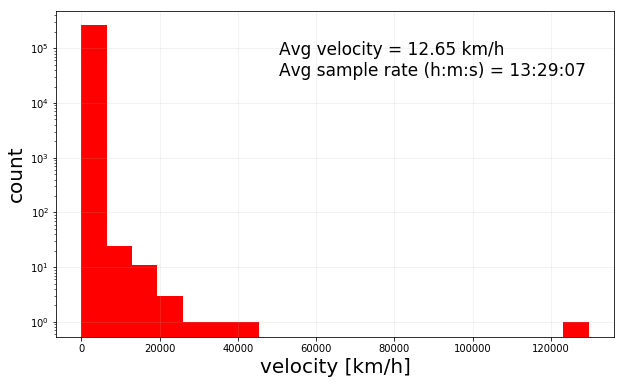

In [21]:
fig = plt.figure(figsize=(10,6))
sample_rate = easyAverage(data.datetime) #I'm interested in the mean sample rate
plt.hist(data.velocity_kmh.values, color ='r',bins=20, log=True)
avg = np.mean(data.velocity_kmh.values)
#print(avg)
plt.annotate('Avg velocity = %s km/h \nAvg sample rate (h:m:s) = %s' %(round(avg,2),sample_rate), xy= (0.4,0.8), 
            xycoords = 'axes fraction', fontsize = 17)
plt.xlabel('velocity [km/h]', fontsize = 20)
plt.ylabel('count', fontsize = 20)
plt.grid(alpha=0.2)    #alpha is a parameter for transparency
plt.show()

In [22]:
data['id']=data.index
high_v = data[data.velocity_kmh > 275].sort_values(by='id').reset_index()
#high_v['iterator']= [i for i,v in high_v.iterrows()]
high_v['id_diff']=[high_v.id.iloc[i]-high_v.id.iloc[i-1] if i!=0 else 0 for i,v in high_v.iterrows()]
high_v.drop(columns='index',inplace=True)
print('Mean difference in high velocity timestamps: %s'%high_v.id_diff[1:].mean())
print('Number of singular noisy points: %s'%len(high_v[high_v.id_diff == 1]))
high_v[:10]

Mean difference in high velocity timestamps: 247.74592521572387
Number of singular noisy points: 239


,lat,lon,datetime,geometry,distance,delta_time,velocity,velocity_kmh,id,id_diff
0,47.247979,18.626225,2017-01-02 21:21:41.300,POINT (18.6262246 47.2479794),1.563947e+03,3.940,396.940900,1428.987241,867,0
1,43.340134,11.325989,2017-01-04 09:00:51.000,POINT (11.3259892 43.3401341),1.789523e+03,15.680,114.127751,410.859903,1655,788
2,43.031096,11.625554,2017-01-04 11:44:50.444,POINT (11.6255544 43.031096),4.920153e+06,1117.317,4403.542754,15852.753916,1757,102
3,43.035096,11.625763,2017-01-04 19:12:20.797,POINT (11.6257625 43.0350964),2.445507e+03,10.421,234.671030,844.815710,1856,99
4,43.300272,11.335128,2017-01-05 10:46:13.424,POINT (11.3351285 43.3002716),3.278544e+03,38.424,85.325411,307.171481,2115,259
5,43.302199,11.375557,2017-01-05 10:46:31.000,POINT (11.3755568 43.3021994),3.276536e+03,17.576,186.421018,671.115665,2116,1
6,43.312116,11.359409,2017-01-05 15:31:42.000,POINT (11.3594089 43.3121158),1.691592e+03,8.066,209.718865,754.987914,2299,183
7,43.302190,11.372429,2017-01-06 01:50:58.094,POINT (11.3724293 43.3021902),2.540540e+03,22.802,111.417432,401.102755,2584,285
8,42.861720,11.073280,2017-01-06 10:31:55.000,POINT (11.0732797 42.8617196),6.169132e+03,45.463,135.695665,488.504393,2684,100
9,42.874989,11.077729,2017-01-06 17:29:11.000,POINT (11.0777291 42.8749891),1.879267e+03,16.774,112.034537,403.324333,3075,391


We observe that:

- the percentage of the 'high velocity points' is very low (0.004%), which means that Google GPS data is very precise 
- the sample rate is very high (>13h). This is because there have been periods where probably the GPS sensor of the mobile phone were turned off

What we do then, is to remove all the points that present a high velocity.

In [23]:
qValue=0.996
q = data.velocity_kmh.quantile(qValue)
quantile = str(round(q))
data_lv =data[data.velocity_kmh < q]

trace = go.Box(
    x=data_lv.velocity_kmh, 
    opacity=0.75,
    jitter=0.1,
    pointpos=0.0,
    marker=dict(
        size=1.5
    ),
    boxmean=True #add mean value (dashed line)
                    )

layout =  go.Layout(
    dict(title = "Contiguous timestamp points with an in between velocity lower than "+quantile+" km/h"),
    xaxis=dict(title='km/h')
)

data_to_plot=[trace]
fig = go.Figure(data=data_to_plot, layout=layout)
iplot(fig)

In [24]:
data = data_lv

<a id='vd'></a>
## Let's visualize the data ([to top](#top))

In [25]:
##visualize data: we use a heatmap to check where data refers

m = folium.Map(location=[ data['lat'].mean(),data['lon'].mean()], # where the map must be centered
               tiles='OpenStreetMap',#'Stamen Toner', # the type of map to load
               zoom_start=5, # the initial zoom
               control_scale=True)

# let's visalize 10K rows
sample_size = 10000
gdf = data.head(sample_size)

hm = plugins.HeatMap(zip(gdf.lat, gdf.lon),
                     min_opacity=1,
                     radius=8, blur=15,
                     max_zoom=1)
m.add_child(hm)
m.add_child(plugins.MeasureControl(position='bottomright'))
m.add_child(plugins.ScrollZoomToggler())
#m.add_child(plugins.Terminator())
m

<a id='tr'></a>
# Trajectories ([to top](#top))

## We want to visualize the trajectories while the person was on vacation

In [26]:
%%time
vacations = data[data.datetime>= '2017-08-06'][data.datetime <='2017-08-12']
trajectories = to_trajectories2(vacations)

CPU times: user 2.93 s, sys: 115 ms, total: 3.04 s
Wall time: 6.45 s


In [27]:
trajectories.sort_values(by='duration',ascending=False)[:10]

,start_time,end_time,geometry,length,duration
392,2017-08-11 14:48:26.375,2017-08-11 18:11:50.000,"LINESTRING (-8.4144816 37.0951452, -8.4144816 ...",0.643653,12203.625
338,2017-08-10 15:26:21.463,2017-08-10 18:17:12.451,"LINESTRING (-8.6723836 37.0908684, -8.6723836 ...",8.681211,10250.988
47,2017-08-06 07:04:53.800,2017-08-06 09:47:04.408,"LINESTRING (-5.9997942 37.3967194, -5.9996289 ...",284.957027,9730.608
306,2017-08-10 01:17:43.385,2017-08-10 03:26:25.193,"LINESTRING (-8.9348311 37.0136324, -8.9348311 ...",0.000000,7721.808
393,2017-08-11 18:14:17.476,2017-08-11 19:59:15.060,"LINESTRING (-8.411424500000001 37.0900714, -8....",45.595198,6297.584
165,2017-08-07 23:05:46.100,2017-08-08 00:36:22.000,"LINESTRING (-8.808111800000001 37.2838845, -8....",0.039173,5435.900
59,2017-08-06 11:56:08.000,2017-08-06 13:24:36.920,"LINESTRING (-8.797874500000001 37.3170879, -8....",15.282722,5308.920
204,2017-08-08 17:53:52.400,2017-08-08 19:11:15.000,"LINESTRING (-8.865073300000001 37.2956115, -8....",55.784454,4642.600
106,2017-08-07 08:58:56.902,2017-08-07 10:14:58.857,"LINESTRING (-8.8013099 37.2889135, -8.8013099 ...",16.410809,4561.955
265,2017-08-09 17:37:57.000,2017-08-09 18:48:42.600,"LINESTRING (-8.9478215 37.0073221, -8.9478215 ...",5.111437,4245.600


In [28]:
m = folium.Map(location=[ vacations['lat'].mean(),vacations['lon'].mean()], 
               tiles='Stamen Terrain',
                zoom_start=8, control_scale=True)

lines = folium.features.GeoJson(trajectories['geometry'].to_json())
m.add_child(lines)
m.add_child(plugins.Fullscreen(
        position='topright',
        title='Expand',
        title_cancel='Exit',
        force_separate_button=True))
m.add_child(plugins.MeasureControl(position='bottomright'))
m.add_child(plugins.ScrollZoomToggler())
m

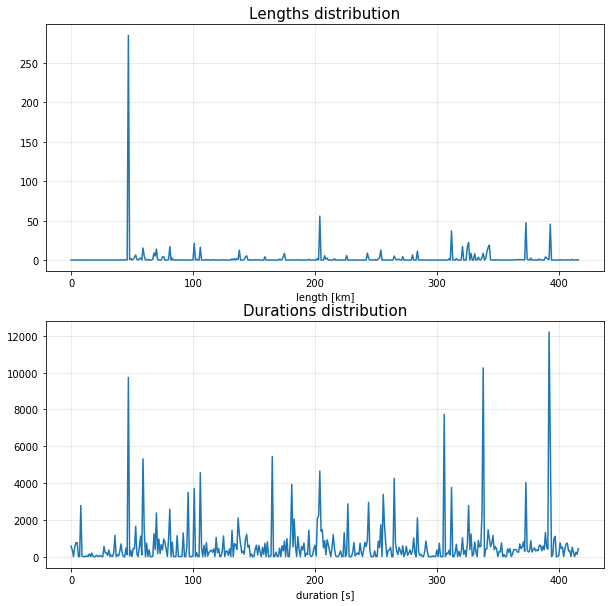

In [29]:
fig = plt.figure(figsize=(10,10))

plt.subplot(2, 1, 1)
plt.plot(trajectories['length'])
plt.title('Lengths distribution', fontsize=15)
plt.xlabel('length [km]', fontsize=10)
plt.grid(alpha=0.3)

plt.subplot(2, 1, 2)
plt.plot(trajectories['duration'])
plt.title('Durations distribution', fontsize=15)
plt.xlabel('duration [s]', fontsize=10)
plt.grid(alpha=0.3)


<a id='wp'></a>
## Now we want to focus on the working months (in Turin) ([to top](#top))


In [30]:
%%time
work = data[data.datetime>= '2017-01-10'][data.datetime <='2017-04-30']
work_trajectories = to_trajectories2(work)

CPU times: user 42.1 s, sys: 263 ms, total: 42.4 s
Wall time: 57.5 s


In [31]:
work_trajectories['tid']=work_trajectories.index
work_trajectories.head()

,start_time,end_time,geometry,length,duration,tid
0,2017-01-10 00:00:38.867,2017-01-10 00:09:47.766,"LINESTRING (7.6748659 45.0631324, 7.6748659 45...",0.043738,548.899,0
1,2017-01-10 00:12:26.842,2017-01-10 00:12:26.842,"LINESTRING (7.6748853 45.0632043, 7.6748853 45...",0.000000,0.000,1
2,2017-01-10 00:14:54.511,2017-01-10 00:20:55.802,"LINESTRING (7.6748659 45.0631324, 7.6748659 45...",0.000000,361.291,2
3,2017-01-10 00:23:56.932,2017-01-10 00:33:59.684,"LINESTRING (7.6748659 45.0631324, 7.6748659 45...",0.000000,602.752,3
4,2017-01-10 00:41:00.894,2017-01-10 06:50:08.938,"LINESTRING (7.6748659 45.0631324, 7.6748659 45...",0.395317,22148.044,4


In [32]:
m = folium.Map(location=[ work['lat'].mean(),work['lon'].mean()], 
               tiles='Stamen Toner',
                zoom_start=9, control_scale=True)

lines = folium.features.GeoJson(work_trajectories[:2500]['geometry'].to_json())
m.add_child(lines)
m.add_child(plugins.MeasureControl(position='bottomright'))
m.add_child(plugins.ScrollZoomToggler())
m

#### As we can notice from the trajectories, he used to work in Turin during the week, and then go to ski to the Alps on the weekends :D

<a id='turin'></a>
# Let's focus on Turin most frequented areas ([to top](#top))

#### Here we compute an OD matrix based on the starting and arriving trajectories. So we can see which are the areas the person used to leave from or arrive to mostly. 
You can find the Turin areas geometry here https://andria.carto.com/tables/torino_zone/public/map (GeoJSON)

In [33]:
areas = gpd.read_file('data/torino_zone.geojson')
areas

,gml_id,id_quartie,nome,cartodb_id,created_at,updated_at,v,geometry
0,,16,Lanzo Madonna di Campagna,3,2015-07-13T10:12:53,2015-07-13T10:14:15,11,"(POLYGON ((7.645204 45.10659, 7.645207 45.1078..."
1,,8,Vanchiglia,6,2015-07-13T10:12:53,2015-07-13T10:14:22,11,"(POLYGON ((7.689677 45.074714, 7.689969 45.074..."
2,,20,Regio Parco,8,2015-07-13T10:12:53,2015-07-13T10:14:26,11,"(POLYGON ((7.740462 45.119452, 7.741522 45.120..."
3,,19,Falchera,9,2015-07-13T10:12:53,2015-07-13T10:14:28,11,"(POLYGON ((7.670911 45.13769, 7.671177 45.1377..."
4,,22,Borgo Po e Cavoretto,11,2015-07-13T10:12:53,2015-07-13T10:14:34,11,"(POLYGON ((7.67395 45.019793, 7.673972 45.0199..."
5,,21,Madonna del Pilone,12,2015-07-13T10:12:53,2015-07-13T10:14:38,11,"(POLYGON ((7.708488 45.068321, 7.708722 45.067..."
6,,9,Nizza Millefonti,22,2015-07-13T10:12:53,2015-07-13T10:16:47,10,"(POLYGON ((7.657648 45.022847, 7.657658 45.023..."
7,,24,Cit Turin,24,2015-07-13T10:12:53,2015-07-13T10:16:54,10,"(POLYGON ((7.656322 45.07606, 7.657185 45.0760..."
8,,6,San Donato,13,2015-07-13T10:12:53,2015-07-13T10:16:30,10,"(POLYGON ((7.643607 45.075874, 7.643746 45.076..."
9,,15,Le Vallette,16,2015-07-13T10:12:53,2015-07-13T10:16:36,10,"(POLYGON ((7.611817 45.107124, 7.612637 45.107..."


In [34]:
'''To get some info about the CRS (Coordinates Reference System)

pyepsg.get(areas.crs['init'].split(':')[1])'''

"To get some info about the CRS (Coordinates Reference System)\n\npyepsg.get(areas.crs['init'].split(':')[1])"

In [35]:
m = folium.Map(location=[45.063841, 7.6776873], #Turin
               tiles='Stamen Toner',
                zoom_start=11, control_scale=True)
#shapes = areas.to_crs(epsg='84')
shapes_child = folium.features.GeoJson(areas)
m.add_child(shapes_child)

m


In [36]:
#we use .copy() otherwise the dataframe is just passed by reference
starting_points = work_trajectories.copy() 
#we get the origin (first point) of each trajectory
starting_points['geometry'] = starting_points['geometry'].apply(lambda x: Point(x.coords[0]))

#we now transform points into locations
origins = gpd.sjoin(starting_points, areas, op='within')

ending_points = work_trajectories.copy()
#here we get the last point of the trajectory now
ending_points['geometry'] = ending_points['geometry'].apply(lambda x: Point(x.coords[-1])) 

destinations = gpd.sjoin(ending_points,areas,op='within')

#merging start point and end point
temp = pd.merge(origins, destinations, on=['tid'])
temp.head()

,start_time_x,end_time_x,geometry_x,length_x,duration_x,tid,index_right_x,gml_id_x,id_quartie_x,nome_x,...,length_y,duration_y,index_right_y,gml_id_y,id_quartie_y,nome_y,cartodb_id_y,created_at_y,updated_at_y,v_y
0,2017-01-10 00:00:38.867,2017-01-10 00:09:47.766,POINT (7.6748659 45.0631324),0.043738,548.899,0,15,,3,Crocetta,...,0.043738,548.899,15,,3,Crocetta,5,2015-07-13T10:12:53,2015-07-13T10:14:19,11
1,2017-01-10 00:12:26.842,2017-01-10 00:12:26.842,POINT (7.6748853 45.0632043),0.000000,0.000,1,15,,3,Crocetta,...,0.000000,0.000,15,,3,Crocetta,5,2015-07-13T10:12:53,2015-07-13T10:14:19,11
2,2017-01-10 00:14:54.511,2017-01-10 00:20:55.802,POINT (7.6748659 45.0631324),0.000000,361.291,2,15,,3,Crocetta,...,0.000000,361.291,15,,3,Crocetta,5,2015-07-13T10:12:53,2015-07-13T10:14:19,11
3,2017-01-10 00:23:56.932,2017-01-10 00:33:59.684,POINT (7.6748659 45.0631324),0.000000,602.752,3,15,,3,Crocetta,...,0.000000,602.752,15,,3,Crocetta,5,2015-07-13T10:12:53,2015-07-13T10:14:19,11
4,2017-01-10 00:41:00.894,2017-01-10 06:50:08.938,POINT (7.6748659 45.0631324),0.395317,22148.044,4,15,,3,Crocetta,...,0.395317,22148.044,15,,3,Crocetta,5,2015-07-13T10:12:53,2015-07-13T10:14:19,11


In [37]:
#now we can group by and count
od_matrix = temp.groupby(['nome_x','nome_y']).agg('count').reset_index()[['nome_x','nome_y','tid']].sort_values('tid', ascending=False)
od_matrix.rename(columns={'tid': 'flow'}, inplace=True)
od_matrix.head()

,nome_x,nome_y,flow
25,Crocetta,Crocetta,3126
8,Borgata Vittoria,Borgata Vittoria,1612
19,Centro,Centro,85
44,San Salvario,San Salvario,55
23,Crocetta,Borgata Vittoria,49


<a id='sttr'></a>
## Let's visualize a heatmap of the starting point of each trajectory ([to top](#top))

In [38]:
origins = temp.groupby('nome_x').agg('count').reset_index()[['nome_x','start_time_x']]
origins.columns = ['quartiere','NumTrips']
origins.sort_values(by='NumTrips', ascending=False, inplace=True)
print(len(origins))
origins.head()

16


,quartiere,NumTrips
4,Crocetta,3206
2,Borgata Vittoria,1727
3,Centro,109
13,San Salvario,67
12,San Donato,46


In [39]:
m = folium.Map(location=[45.063841, 7.6776873], #Turin
               tiles='OpenStreetMap',
                zoom_start=11, control_scale=True)
#shapes = areas.to_crs(epsg='84')
shapes_child = folium.features.GeoJson(areas)
m.add_child(shapes_child)

m.choropleth(
    geo_data = areas.reset_index().to_json(), #.reset_index().set_index('nome').to_json(),
    data = origins,
    columns=['quartiere','NumTrips'],
    key_on='feature.properties.nome',
    fill_color='Reds',
    legend_name='N. of starting trajectories',
    highlight=True,
    fill_opacity=0.6
)
for row in areas.iterrows():
    location_name = '%s'%(row[1]['nome'])
    
    trips_number = origins[origins['quartiere'] == row[1]['nome']]['NumTrips']
    if len(trips_number)== 0: #no trips
        trips_number=0
    else:
        trips_number = int(trips_number)
    icon_url = 'http://icons.iconarchive.com/icons/icons-land/vista-map-markers/256/Map-Marker-Push-Pin-1-Right-Chartreuse-icon.png'
    icon = folium.features.CustomIcon(icon_url,icon_size=(25, 25))
    
    folium.Marker(
    location=[row[1]['geometry'].centroid.y,row[1]['geometry'].centroid.x],
    popup='%s <br>Trips: %s'%(location_name, trips_number),
    icon=icon).add_to(m)
    
m.add_child(plugins.MeasureControl(position='bottomright'))

m

### We can state that the trips started mostly from home (Crocetta neighbourhood) and from the workplace (Borgata Vittoria neighbourhood)

<a id='artr'></a>
## We want to check the destination areas now ([to top](#top))

In [40]:
destinations = temp.groupby('nome_y').agg('count').reset_index()[['nome_y','end_time_y']]
destinations.columns = ['quartiere','NumTrips']
destinations.sort_values(by='NumTrips', ascending=False, inplace=True)

m = folium.Map(location=[45.063841, 7.6776873], #Turin
               tiles='OpenStreetMap',
                zoom_start=11, control_scale=True)
#shapes = areas.to_crs(epsg='84')
shapes_child = folium.features.GeoJson(areas)
m.add_child(shapes_child)

m.choropleth(
    geo_data = areas.reset_index().to_json(), #.reset_index().set_index('nome').to_json(),
    data = destinations,
    columns=['quartiere','NumTrips'],
    key_on='feature.properties.nome',
    fill_color='Reds',
    legend_name='N. of ending trajectories',
    highlight=True,
    fill_opacity=0.6
)
for row in areas.iterrows():
    location_name = '%s'%(row[1]['nome'])
    
    trips_number = destinations[destinations['quartiere'] == row[1]['nome']]['NumTrips']
    if len(trips_number)== 0: #no trips
        trips_number=0
    else:
        trips_number = int(trips_number)
    icon_url = 'http://www.iconarchive.com/download/i57814/icons-land/vista-map-markers/Map-Marker-Flag-2-Right-Pink.ico'
    icon = folium.features.CustomIcon(icon_url,icon_size=(25, 25))
    
    folium.Marker(
    location=[row[1]['geometry'].centroid.y,row[1]['geometry'].centroid.x],
    popup='%s <br>Trips: %s'%(location_name, trips_number),
    icon=icon).add_to(m)
    
m.add_child(plugins.MeasureControl(position='bottomright'))

m

Also the destinations study shows that the most visited areas are home and workplace.

<a id='movie'></a>
# Mini Movies ([to top](#top))

## We want to give a live representation of a typical day in Turin.

In [41]:
day_sample = data[data.datetime >= '2017-05-22'][data.datetime <'2017-05-23']
day_sample=day_sample.sort_values(by='datetime', ascending=True).reset_index()

day_sample[:10]

,index,lat,lon,datetime,geometry,distance,delta_time,velocity,velocity_kmh,id
0,85026,45.063230,7.673252,2017-05-22 05:04:35.691,POINT (7.6732524 45.0632297),112.299522,22563.942,0.004977,0.017917,85026
1,85027,45.062988,7.674827,2017-05-22 05:05:41.019,POINT (7.674827 45.0629883),126.469246,65.328,1.935912,6.969282,85027
2,85028,45.062988,7.674827,2017-05-22 05:06:42.006,POINT (7.674827 45.0629883),0.000000,60.987,0.000000,0.000000,85028
3,85029,45.062988,7.674827,2017-05-22 05:06:47.971,POINT (7.674827 45.0629883),0.000000,5.965,0.000000,0.000000,85029
4,85030,45.063099,7.674813,2017-05-22 05:07:49.003,POINT (7.6748134 45.0630992),12.369921,61.032,0.202679,0.729645,85030
5,85031,45.063099,7.674813,2017-05-22 05:08:30.184,POINT (7.6748134 45.0630992),0.000000,41.181,0.000000,0.000000,85031
6,85032,45.062988,7.674827,2017-05-22 05:09:34.472,POINT (7.674827 45.0629883),12.369921,64.288,0.192414,0.692691,85032
7,85033,45.062988,7.674827,2017-05-22 05:10:03.471,POINT (7.674827 45.0629883),0.000000,28.999,0.000000,0.000000,85033
8,85034,45.063066,7.674761,2017-05-22 05:10:54.646,POINT (7.6747608 45.0630661),10.086855,51.175,0.197105,0.709578,85034
9,85035,45.063066,7.674761,2017-05-22 05:11:54.703,POINT (7.6747608 45.0630661),0.000000,60.057,0.000000,0.000000,85035


In [42]:
print(day_sample['distance'].mean())

print(len(day_sample))

print(len(day_sample[day_sample['distance']>=35]))

35.066023737272616
939
268


Since it's too much data to plot, we consider just a sample of the trajectories.

In [43]:
day_sample = day_sample[day_sample['distance']>=35] \
        .sample(125) \
        .sort_values(by='datetime') \
        .reset_index() \
        .drop(columns=['level_0','index'])

day_sample.tail()

,lat,lon,datetime,geometry,distance,delta_time,velocity,velocity_kmh,id
120,45.056827,7.668247,2017-05-22 18:10:50.000,POINT (7.6682466 45.0568266),37.915292,15.000,2.527686,9.099670,85813
121,45.057596,7.669297,2017-05-22 18:12:30.000,POINT (7.6692967 45.0575963),78.671206,27.963,2.813404,10.128253,85818
122,45.063269,7.673377,2017-05-22 18:21:25.329,POINT (7.6733773 45.0632693),487.640024,349.329,1.395933,5.025360,85830
123,45.062045,7.674535,2017-05-22 18:21:41.000,POINT (7.6745351 45.0620448),163.629031,15.671,10.441518,37.589465,85831
124,45.063177,7.674747,2017-05-22 18:40:26.307,POINT (7.6747472 45.0631771),72.845814,62.583,1.163987,4.190354,85857


In [44]:
m = folium.Map(
    location=[day_sample['lat'].mean(), day_sample['lon'].mean()],
    zoom_start=13,
    control_scale=True
)

# Lon, Lat order.
lines=[]
for i, row in day_sample.iterrows():
    if i == len(day_sample)-1:
        continue
    else:
        lines.append(
            {
                'coordinates': [
                    [day_sample.iloc[i]['lon'], day_sample.iloc[i]['lat']],
                    [day_sample.iloc[i+1]['lon'], day_sample.iloc[i+1]['lat']],
                ],
                'dates': [
                    str(day_sample.iloc[i]['datetime']),
                    str(day_sample.iloc[i+1]['datetime'])
                ],
            },
        )
           
features = [
    {
        'type': 'Feature',
        'geometry': {
            'type': 'LineString',
            'coordinates': line['coordinates'],
        },
        'properties': {
            'times': line['dates'],
            'style': {
                'color': 'red',
                'weight': line['weight'] if 'weight' in line else 5
            }
        },
    }
    for line in lines
]


plugins.TimestampedGeoJson({
    'type': 'FeatureCollection',
    'features': features,
    'icon': 'red',
}, transition_time = 667, period='PT10M', add_last_point=True).add_to(m)

m.add_child(plugins.Fullscreen(
        position='topright',
        title='Expand',
        title_cancel='Exit',
        force_separate_button=True))
m.add_child(plugins.MeasureControl(position='bottomright'))

m

<a id='vacation'></a>
## A day on vacation ([to top](#top))

Visualizing trajectories on a vacation day in The Hague, The Netherlands.

In [45]:
day_sample = data[data.datetime >= '2017-11-01 11:00:00'][data.datetime <'2017-11-02 00:00:00']
day_sample = day_sample.sort_values(by='datetime', ascending=True).reset_index()

day_sample = day_sample[day_sample['distance']>=35] \
        .sort_values(by='datetime') \
        .reset_index() \
        .drop(columns=['level_0','index'])

day_sample.tail()

,lat,lon,datetime,geometry,distance,delta_time,velocity,velocity_kmh,id
115,52.079053,4.300371,2017-11-01 20:58:57.292,POINT (4.3003713 52.079053),160.360173,126.106,1.271630,4.577868,163894
116,52.078089,4.298659,2017-11-01 21:00:58.186,POINT (4.2986587 52.0780886),158.636195,120.894,1.312192,4.723893,163895
117,52.077310,4.296391,2017-11-01 21:03:19.701,POINT (4.2963905 52.0773104),160.293133,120.901,1.325821,4.772957,163897
118,52.076712,4.294011,2017-11-01 21:05:21.908,POINT (4.2940108 52.0767125),175.584324,122.207,1.436778,5.172401,163898
119,52.075407,4.292843,2017-11-01 21:07:27.213,POINT (4.292843 52.0754067),165.582934,125.305,1.321439,4.757181,163899


In [46]:
m = folium.Map(
    location=[day_sample['lat'].mean(), day_sample['lon'].mean()],
    zoom_start=13,
    control_scale=True
)

# Lon, Lat order.
lines=[]
for i, row in day_sample.iterrows():
    if i == len(day_sample)-1:
        continue
    else:
        lines.append(
            {
                'coordinates': [
                    [day_sample.iloc[i]['lon'], day_sample.iloc[i]['lat']],
                    [day_sample.iloc[i+1]['lon'], day_sample.iloc[i+1]['lat']],
                ],
                'dates': [
                    str(day_sample.iloc[i]['datetime']),
                    str(day_sample.iloc[i+1]['datetime'])
                ],
            },
        )
           
features = [
    {
        'type': 'Feature',
        'geometry': {
            'type': 'LineString',
            'coordinates': line['coordinates'],
        },
        'properties': {
            'times': line['dates'],
            'style': {
                'color': 'red',
                'weight': line['weight'] if 'weight' in line else 5
            }
        },
    }
    for line in lines
]


plugins.TimestampedGeoJson({
    'type': 'FeatureCollection',
    'features': features,
    'icon': 'red',
}, transition_time = 667, period='PT10M', add_last_point=True).add_to(m)

m.add_child(plugins.Fullscreen(
        position='topright',
        title='Expand',
        title_cancel='Exit',
        force_separate_button=True))
m.add_child(plugins.MeasureControl(position='bottomright'))

m

<a id='tc'></a>
# Trajectory clustering ([to top](#top))

#### Here we want the data to tell us whether recurrent trajectories are frequent. We will focus on the work trajectories obtained above.

<a id='km'></a>
## K-Means ([to top](#top))

### Working period

In [47]:
%time
work_trajectories = to_trajectories3(work)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 8.11 µs


In [48]:
work_trajectories.columns=['start_lon','start_lat','end_lon','end_lat','length','duration','geometry']
work_trajectories.head()

,start_lon,start_lat,end_lon,end_lat,length,duration,geometry
0,7.674866,45.063132,7.674885,45.063204,0.043738,548.899,"LINESTRING (7.6748659 45.0631324, 7.6748659 45..."
1,7.674885,45.063204,7.674885,45.063204,0.000000,0.000,"LINESTRING (7.6748853 45.0632043, 7.6748853 45..."
2,7.674866,45.063132,7.674866,45.063132,0.000000,361.291,"LINESTRING (7.6748659 45.0631324, 7.6748659 45..."
3,7.674866,45.063132,7.674866,45.063132,0.000000,602.752,"LINESTRING (7.6748659 45.0631324, 7.6748659 45..."
4,7.674866,45.063132,7.674813,45.063099,0.395317,22148.044,"LINESTRING (7.6748659 45.0631324, 7.6748659 45..."


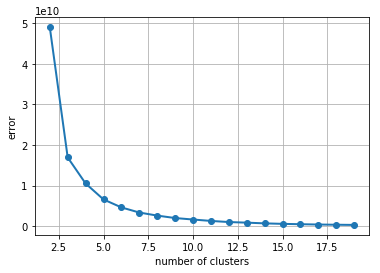

In [49]:
X = work_trajectories[['start_lat','start_lon','end_lat','end_lon','length','duration']].values
errors = []
#what is the best k?
for k in range(2, 20):
    kmeans = KMeans(n_clusters=k, random_state=0).fit(X)
    sse = kmeans.inertia_
    errors.append((k, sse))
    
plt.plot([x[0] for x in errors], [x[1] for x in errors], "-o", linewidth=2)
plt.xlabel("number of clusters")
plt.ylabel("error")
plt.grid()
plt.show()

We distinguish 5 main clusters.

In [50]:
kmeans = KMeans(n_clusters=5, random_state=0).fit(X)

closest, _ = pairwise_distances_argmin_min(kmeans.cluster_centers_, X)
m = folium.Map(location=[ work['lat'].mean(),work['lon'].mean()], 
               tiles='Stamen Toner',
                zoom_start=10, control_scale=True)

for idx, color in zip(closest, ['black', 'blue', 'red', 'yellow', 'green']):
    centroid = X[idx]
    trip = [list(centroid[:2]), list(centroid[2:4])]
    length, duration = centroid[4], centroid[5]
    label = "duration (s): %s<br>length (km): %s" %(duration, round(length,2))
    folium.PolyLine(trip, popup=label, color=color, weight=5.5, opacity=1).add_to(m)
    arrows = get_arrows(trip, n_arrows=2, color=color)
    for arrow in arrows:
        arrow.add_to(m) 
m

#### As we can see, all the clusters begin from home. There are two clusters that are basically home and workplace. Indeed, one of the remaining 3 trajectories is exactly home --> workplace.

<a id='btr'></a>
### Business trips ([to top](#top))

On September 2017, the guy used to do business trips in a small village in the Monferrato area.
Let's visualize the clusters of this period.

In [51]:
%time
work_transfer=data[data['datetime']>= '2017-09-05'][data['datetime']<= '2017-09-19']
business_trips = to_trajectories3(work_transfer)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 7.87 µs


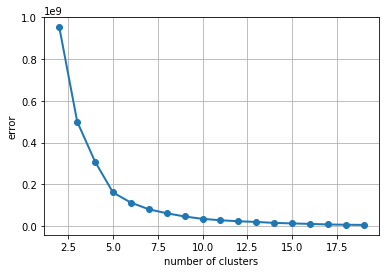

In [52]:
X = business_trips[['start_lat','start_lon','end_lat','end_lon','length','duration']].values
errors = []
#what is the best k?
for k in range(2, 20):
    kmeans = KMeans(n_clusters=k, random_state=0).fit(X)
    sse = kmeans.inertia_
    errors.append((k, sse))
    
plt.plot([x[0] for x in errors], [x[1] for x in errors], "-o", linewidth=2)
plt.xlabel("number of clusters")
plt.ylabel("error")
plt.grid()
plt.show()

Let's see what we obtain with 5 clusters.

In [53]:
kmeans = KMeans(n_clusters=6, random_state=0).fit(X)

closest, _ = pairwise_distances_argmin_min(kmeans.cluster_centers_, X)
m = folium.Map(location=[ work_transfer['lat'].mean(),work_transfer['lon'].mean()], 
               tiles='Stamen Toner',
                zoom_start=10, control_scale=True)

for idx, color in zip(closest, ['black', 'blue', 'red', 'yellow', 'green']):
    centroid = X[idx]
    trip = [list(centroid[:2]), list(centroid[2:4])]
    length, duration = centroid[4], centroid[5]
    label = "duration: %s min<br>length: %s km" %(round(duration/60,2), round(length,2))
    folium.PolyLine(trip, popup=label, color=color, weight=5.5, opacity=1).add_to(m)
    arrows = get_arrows(trip, n_arrows=2, color=color)
    for arrow in arrows:
        arrow.add_to(m) 
m

#### The only clear cluster is the one from Turin to Capriata d'Orba, the place where the person used to go to work.

<a id='dbscan'></a>
## Some results with the DBSCAN clustering ([to top](#top))

In [54]:
coords = work_transfer.as_matrix(columns=['lat', 'lon'])

dbscan = DBSCAN(eps=0.0001, min_samples=1, algorithm='auto', metric='euclidean').fit(np.radians(coords))
cluster_labels = dbscan.labels_
num_clusters = len(set(cluster_labels))
clusters = pd.Series([coords[cluster_labels == n] for n in range(num_clusters)])
print('Number of clusters: {}'.format(num_clusters))

Number of clusters: 12


In [55]:
'''
This function returns the center-most point from a cluster by taking a set of points (i.e., a cluster) 
and returning the point within it that is nearest to some reference point (in this case, the cluster’s centroid).
'''
def get_centermost_point(cluster):
    centroid = (MultiPoint(cluster).centroid.x, MultiPoint(cluster).centroid.y)
    centermost_point = min(cluster, key=lambda point: great_circle(point, centroid).m)
    return tuple(centermost_point)

In [56]:
centermost_points = clusters.map(get_centermost_point)
lats, lons = zip(*centermost_points)
rep_points = pd.DataFrame({'lon':lons, 'lat':lats})

In [57]:
rs = rep_points.apply(lambda row: work_transfer[(work_transfer['lat']==row['lat']) & (work_transfer['lon']==row['lon'])].iloc[0], axis=1)
rs

,lat,lon,datetime,geometry,distance,delta_time,velocity,velocity_kmh,id
0,44.904601,8.096185,2017-09-15 16:40:24.000,POINT (8.096184900000001 44.9046006),512.632821,16.000,32.039551,115.342385,139678
1,44.688004,8.644497,2017-09-05 16:38:45.894,POINT (8.6444966 44.6880043),969.587187,120.588,8.040495,28.945781,133903
2,44.692625,8.629718,2017-09-05 16:46:13.698,POINT (8.6297183 44.6926247),1957.097964,35.267,55.493747,199.777488,133912
3,44.736593,8.726291,2017-09-05 18:37:49.224,POINT (8.7262906 44.7365927),0.000000,61.802,0.000000,0.000000,134013
4,44.765306,8.772972,2017-09-06 18:51:33.000,POINT (8.772971800000001 44.7653057),160.113938,15.000,10.674263,38.427345,134567
5,44.776153,8.713005,2017-09-06 20:20:15.147,POINT (8.7130051 44.7761528),4848.408345,121.076,40.044339,144.159619,134619
6,44.768434,8.642496,2017-09-06 20:28:29.464,POINT (8.6424957 44.7684338),6300.178520,372.591,16.909100,60.872760,134621
7,44.578606,8.664012,2017-09-06 21:15:58.480,POINT (8.664012100000001 44.5786061),12742.661323,300.047,42.468884,152.887983,134656
8,44.738210,8.733978,2017-09-08 05:54:26.478,POINT (8.733978499999999 44.7382097),629.236311,241.365,2.606991,9.385167,135092
9,45.107246,7.697206,2017-09-14 06:25:53.451,POINT (7.6972061 45.107246),2644.951422,120.038,22.034284,79.323424,138434


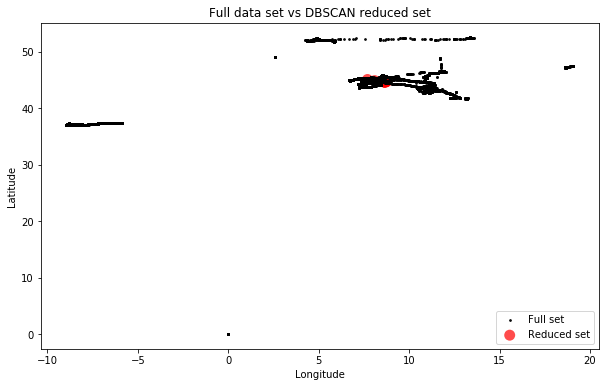

In [58]:
fig, ax = plt.subplots(figsize=[10, 6])
rs_scatter = ax.scatter(rs['lon'], rs['lat'], c='r', edgecolor='None', alpha=0.7, s=120)
df_scatter = ax.scatter(df['lon'], df['lat'], c='k', alpha=0.9, s=3)
ax.set_title('Full data set vs DBSCAN reduced set')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.legend([df_scatter, rs_scatter], ['Full set', 'Reduced set'], loc='lower right')
plt.show()

#### The above figure is a representation of the resulting trajectories on a blank plot

#### Below, we visualize the centroids of the trajectories obtained by the DBSCAN clustering

In [59]:
m = folium.Map(location=[ work_transfer['lat'].mean(),work_transfer['lon'].mean()], 
               tiles='OpenStreetMap',
                zoom_start=10, control_scale=True)

for row in rs.iterrows():
    icon_url = 'https://png.icons8.com/metro/1600/place-marker.png'
    icon = folium.features.CustomIcon(icon_url,icon_size=(25, 25))
    
    folium.Marker(
    location=[row[1]['geometry'].centroid.y,row[1]['geometry'].centroid.x],
    popup='Centroid %s'%(row[0]),
    icon=icon).add_to(m)
    
m.add_child(plugins.MeasureControl(position='bottomright'))

m

<a id='indices'></a>
# Significant indices ([to top](#top))

#### We extrapolate and study some mobility indices over time

<a id='rog'></a>
## Radius of gyration ([to top](#top))

The *radius of gyration* of an individual $u$ is the <u>characteristic traveled distance</u> during a period of time, and it is formally defined as: 
$$r_g(u) = \sqrt{\frac{1}{N} \sum_i^N{w_i (r_i - r_{cm})^2}}$$
where $N$ is the number of visits of $u$, $w_i$ is the number of times $u$ visited location $i$, $r_i$ is the pair of coordinates of location $i$, $r_{cm}$ is the *center of mass* (i.e., the average position) of $u$. The center of mass is easily defined as:
$$r_{cm} = \frac{1}{N} \sum_i^N r_i.$$

In [60]:
radius_of_gyration(data)

308.9805221031394

<a id='rogseq'></a>
### Study of radius of gyration evolution on sequential periods ([to top](#top))

In [61]:
data['Mese']=data['datetime'].dt.month
data['Settimana']=data['datetime'].dt.week
data['Giorno']=data['datetime'].dt.weekday_name
data.tail()

,lat,lon,datetime,geometry,distance,delta_time,velocity,velocity_kmh,id,Mese,Settimana,Giorno
260612,46.476655,11.743967,2017-12-30 23:51:42.707,POINT (11.7439674 46.4766549),0.0,124.364,0.0,0.0,260612,12,52,Saturday
260613,46.476655,11.743967,2017-12-30 23:53:47.414,POINT (11.7439674 46.4766549),0.0,124.707,0.0,0.0,260613,12,52,Saturday
260614,46.476655,11.743967,2017-12-30 23:54:49.572,POINT (11.7439674 46.4766549),0.0,62.158,0.0,0.0,260614,12,52,Saturday
260615,46.476655,11.743967,2017-12-30 23:55:50.474,POINT (11.7439674 46.4766549),0.0,60.902,0.0,0.0,260615,12,52,Saturday
260616,46.476655,11.743967,2017-12-30 23:57:56.346,POINT (11.7439674 46.4766549),0.0,125.872,0.0,0.0,260616,12,52,Saturday


In [62]:
rog_permonth = data.groupby(by='Mese').apply(lambda x: radius_of_gyration(x))

rog_permonth

Mese
1     239.867399
2      21.690705
3      85.737555
4     126.202766
5      95.626757
6     116.926350
7     128.408766
8     792.045572
9      40.431408
10    279.762712
11    255.689802
12    191.937282
dtype: float64

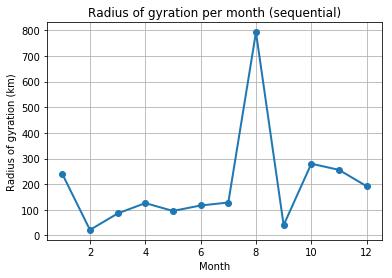

In [63]:
plt.plot([x[0] for x in rog_permonth.iteritems()], rog_permonth, "-o", linewidth=2)
plt.title('Radius of gyration per month (sequential)')
plt.xlabel("Month")
plt.ylabel("Radius of gyration (km)")
plt.grid()
plt.show()

In [64]:
#To visualize in a more interactive way
trace= go.Scatter(
    x=[x[0] for x in rog_permonth.iteritems()],
    y=rog_permonth,
    text = 'km'
)
layout =  go.Layout(
    dict(title = "Radius of gyration per month (sequential)"),
    xaxis=dict(title='Month'),
    yaxis=dict(title='ROG')
)

data_to_plot=[trace]

fig=go.Figure(data=data_to_plot, layout=layout)
iplot(fig)

In [65]:
rog_perweek = data.groupby(by='Settimana').apply(lambda x: radius_of_gyration(x))

trace= go.Scatter(
    x=[x[0] for x in rog_perweek.iteritems()],
    y=rog_perweek,
    text = 'km'
)
layout =  go.Layout(
    dict(title = "Radius of gyration per week (sequential)"),
    xaxis=dict(title='Week'),
    yaxis=dict(title='ROG')
)

data_to_plot=[trace]

fig=go.Figure(data=data_to_plot, layout=layout)
iplot(fig)

<a id='roginc'></a>
### Study of radius of gyration evolution on incremental periods (monthly increment) ([to top](#top))
Basically, we compute the radius of gyration by considering an incremental time period. 
- 1: Jan
- 2: Jan-Feb
- 3: Jan-Feb-Mar
- ... and so on

In [66]:
incremental_data=[data[data['Mese']<=i] for i in set(data.Mese)]

In [67]:
incremental_rog_month = {i+1:radius_of_gyration(v) for i,v in enumerate(incremental_data)}
incremental_rog_month

{1: 239.86739890155485,
 2: 176.58344294046643,
 3: 151.56639266233674,
 4: 146.18284699959605,
 5: 136.40501203907,
 6: 134.71438853298656,
 7: 134.73173724052245,
 8: 354.90956024489236,
 9: 340.7828473599118,
 10: 335.4281104420237,
 11: 320.93731177145594,
 12: 308.9805221031394}

In [68]:
trace= go.Scatter(
    x=[k for k,v in incremental_rog_month.items()],
    y=[v for k,v in incremental_rog_month.items()],
    text = 'km'
)
layout =  go.Layout(
    dict(title = "Radius of gyration per month (incremental)"),
    xaxis=dict(title='Month'),
    yaxis=dict(title='ROG')
)

data_to_plot=[trace]

fig=go.Figure(data=data_to_plot, layout=layout)
iplot(fig)

<a id='rogweek'></a>
### Study of radius of gyration evolution on an incremental period (weekly increment) ([to top](#top))

In [69]:
incremental_data_week=[data[data['Settimana']<=i] for i in set(data.Settimana)]
incremental_rog_week = {i+1:radius_of_gyration(v) for i,v in enumerate(incremental_data_week)}

trace= go.Scatter(
    x=[k for k,v in incremental_rog_week.items()],
    y=[v for k,v in incremental_rog_week.items()],
    text = 'km'
)
layout =  go.Layout(
    dict(title = "Radius of gyration per week (incremental)"),
    xaxis=dict(title='Week'),
    yaxis=dict(title='ROG')
)

data_to_plot=[trace]

fig=go.Figure(data=data_to_plot, layout=layout)
iplot(fig)

<a id='seqinc'></a>
### Sequential vs incremental rog plot (per month) ([to top](#top))

In [70]:
trace_1= go.Scatter(
    x=[x[0] for x in rog_permonth.iteritems()],
    y=rog_permonth,
    name='sequential',
    line=dict(
        color='red'
    )  
)

trace_2= go.Scatter(
    x=[k for k,v in incremental_rog_month.items()],
    y=[v for k,v in incremental_rog_month.items()],
    name = 'incremental',
    line=dict(
        color='blue'
    )
)


data_to_plot=[trace_1,trace_2]

fig=go.Figure(data=data_to_plot)
iplot(fig)

#### The above plot show how more robust to variations is the curve of the ROG considering the incremental past history. This means that the more time chronology gps data we have of a user, the more the rog converges to a steady state value.

<a id='entropy'></a>
## Mobility Entropy ([to top](#top))
The *uncorrelated entropy* of an individual $u$ measures the predictability of their movements in period of time. It is formally defined as: 
            $$S_{unc} = -\sum_i^N p_i \log p_i $$
where $p_i$ is $u$'s probability of visiting location $i$. We can also normalize the uncorrelated entropy by dividing it by $\log_2 N$.


In [71]:
print('Uncorrelated entropy of the whole 2017 year: %s'%uncorrelated_entropy(data))
print('Random entropy of the whole 2017 year: %s'%random_entropy(data))

Uncorrelated entropy of the whole 2017 year: 9.032439522197153
Random entropy of the whole 2017 year: 16.466188012240888


<a id='seqincmonth'></a>
### Sequential vs incremental uncorrelated entropy plot (per month) ([to top](#top))

In [72]:
entr_permonth = data.groupby(by='Mese').apply(lambda x: uncorrelated_entropy(x))
incremental_entr_month = {i+1:uncorrelated_entropy(v) for i,v in enumerate(incremental_data)}

trace_1= go.Scatter(
    x=[x[0] for x in entr_permonth.iteritems()],
    y=entr_permonth,
    name='sequential',
    line=dict(
        color='red'
    )  
)

trace_2= go.Scatter(
    x=[k for k,v in incremental_entr_month.items()],
    y=[v for k,v in incremental_entr_month.items()],
    name = 'incremental',
    line=dict(
        color='blue'
    )
)


data_to_plot=[trace_1,trace_2]

fig=go.Figure(data=data_to_plot)
iplot(fig)

<a id='seqincweek'></a>
### Sequential vs incremental uncorrelated entropy plot (per week) ([to top](#top))

In [73]:
entr_perweek = data.groupby(by='Settimana').apply(lambda x: uncorrelated_entropy(x))
incremental_entr_week = {i+1:uncorrelated_entropy(v) for i,v in enumerate(incremental_data_week)}


trace_1= go.Scatter(
    x=[x[0] for x in entr_perweek.iteritems()],
    y=entr_perweek,
    name='sequential',
    line=dict(
        color='red'
    )  
)

trace_2= go.Scatter(
    x=[k for k,v in incremental_entr_week.items()],
    y=[v for k,v in incremental_entr_week.items()],
    name = 'incremental',
    line=dict(
        color='blue'
    )
)


data_to_plot=[trace_1,trace_2]

fig=go.Figure(data=data_to_plot)
iplot(fig)

#### We observe that the incremental entropy tends to steadily grow over the year. This is probably due to the fact that as time goes, the person increases the probability of visiting new places, hence resulting in a growing curve.

<a id='profile'></a>
# Profiling ([to top](#top))

## Home location

The most common way to detect the "home" location of an individual is to select the locations where the user is most frequently present during nighttime.

In [74]:
home_loc=list(home(data))
print(home_loc,'\n')

print('These are the exact coordinates of the person\'s previous home in Turin')

m=folium.Map(location=[home_loc[0], home_loc[1]],zoom_start=16)
icon=folium.Icon(icon='home',color='red')
folium.Marker([home_loc[0], home_loc[1]],icon=icon).add_to(m)

m

[45.0630688, 7.674795] 

These are the exact coordinates of the person's previous home in Turin


In [75]:
profile = mobility_profile(data)

pd.DataFrame(
    {'Home location': [profile[0]],
     'Tot number of locations': profile[1],
     'Radius of gyration (km)': profile[2],
     'Random entropy': profile[3],
     'Uncorrelated entropy': profile[4],
     'Maximum travelled distance (km)': profile[5],
     'Straight line distance (km)': profile[6]
    })

,Home location,Tot number of locations,Radius of gyration (km),Random entropy,Uncorrelated entropy,Maximum travelled distance (km),Straight line distance (km)
0,"(45.0630688, 7.674795)",90535,308.980522,16.466188,9.03244,1627.156248,81678.101265


<a id='conclusions'></a>
# Conclusions ([to top](#top))

## This is the end of our project

### To make a recap of the overall work, what we did was:

- Downloading the GeoJson of Google Maps history data of a member of our group
- Removing noisy points
- Visualizing trajectories on different time windows
- Visualizing the most frequented areas in Turin
- Visualizing 'a typical working day' and 'a day on vacation' minimovie
- Clustering of recurrent trajectories on different time windows
- Studying the radius of gyration and the uncorrelated entropy on a sequential and incremental period
- Extracting some significant indices from the data as to label a user's profile

With the below pic, we leave you with a consideration of ours at the end of the project:

![getajob](img/getajob.jpg)
<p></p>